This notebook, together with the methods in the file `plot_vars.py` and `result_methods.py` serve to define the ecosystems' vulnerability and risk under climate change. The frequency distribution maps can be regenerated with the notebook `TC_P_freq_cat_saffir.ipynb`.

# Tropical cyclones and global ecosystems 

In [64]:
%load_ext autoreload
%autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [65]:
from plot_vars import oceans_plot, ecoreg_plot

In [66]:
ocean_atlantic = oceans_plot('atlantic')
ecoreg_atlantic = ecoreg_plot('atlantic')

In [67]:
ocean_pacific = oceans_plot('pacific')
ecoreg_pacific = ecoreg_plot('pacific')

In [68]:
import geopandas as gpd
ecoreg_area_km = gpd.read_file('Data/Ecoregions2017/Ecoregions2017_corrected.shp')
ecoreg_area_km = ecoreg_area_km.sort_values('ECO_NAME')
ecoreg_area_km = ecoreg_area_km.set_index('ECO_NAME')
ecoreg_area_km

,OBJECTID,BIOME_NAME,REALM,ECO_ID,SHAPE_AREA,geometry
ECO_NAME,,,,,,
Adelie Land tundra,1.0,Tundra,Antarctica,117,177.624779,"MULTIPOLYGON (((158.71410 -69.60657, 158.71264..."
Admiralty Islands lowland rain forests,2.0,Tropical & Subtropical Moist Broadleaf Forests,Australasia,135,2098.541381,"MULTIPOLYGON (((147.28819 -2.57589, 147.27150 ..."
Aegean and Western Turkey sclerophyllous and mixed forests,3.0,"Mediterranean Forests, Woodlands & Scrub",Palearctic,785,133558.185743,"MULTIPOLYGON (((26.88659 35.32161, 26.88297 35..."
Afghan Mountains semi-desert,4.0,Deserts & Xeric Shrublands,Palearctic,807,13682.449850,"MULTIPOLYGON (((65.48655 34.71401, 65.52872 34..."
Ahklun and Kilbuck Upland Tundra,5.0,Tundra,Nearctic,404,50824.460415,"MULTIPOLYGON (((-160.26404 58.64097, -160.2673..."
...,...,...,...,...,...,...
Zambezian coastal flooded savanna,815.0,Flooded Grasslands & Savannas,Afrotropic,75,19369.020792,"MULTIPOLYGON (((35.06521 -21.00783, 35.07296 -..."
Zambezian evergreen dry forests,817.0,Tropical & Subtropical Dry Broadleaf Forests,Afrotropic,33,31576.894872,"MULTIPOLYGON (((25.02083 -15.98167, 25.02083 -..."
Zambezian flooded grasslands,818.0,Flooded Grasslands & Savannas,Afrotropic,76,201935.742349,"MULTIPOLYGON (((21.70383 -18.20102, 21.70838 -..."


In [69]:
import numpy as np
ecoreg_area_too_small = ecoreg_area_km.loc[~np.isin(ecoreg_area_km.index.values, ecoreg_atlantic.ECO_NAME.values)].reset_index()
ecoreg_area_too_small

,ECO_NAME,OBJECTID,BIOME_NAME,REALM,ECO_ID,SHAPE_AREA,geometry
0,Malpelo Island xeric scrub,415.0,Deserts & Xeric Shrublands,Neotropic,604,7.655598,"POLYGON ((-81.58213 3.99123, -81.57854 3.97784..."
1,St. Peter and St. Paul Rocks,700.0,Deserts & Xeric Shrublands,Neotropic,609,6.042218,"MULTIPOLYGON (((-29.27657 0.91939, -29.27772 0..."
2,Trindade-Martin Vaz Islands tropical forests,840.0,Tropical & Subtropical Moist Broadleaf Forests,Neotropic,509,9.255432,"MULTIPOLYGON (((-29.84472 -20.49806, -29.84889..."


In [70]:
# Not considered ecosystems.
[name for name in ecoreg_area_km.reset_index().ECO_NAME.values if name not in ecoreg_atlantic.ECO_NAME.values]

['Malpelo Island xeric scrub',
 'St. Peter and St. Paul Rocks',
 'Trindade-Martin Vaz Islands tropical forests']

In [71]:
ecoreg_area_km = ecoreg_area_km.loc[ecoreg_atlantic.ECO_NAME.values].reset_index()
gdf_affected_ecoreg  = ecoreg_area_km

# Maps

## TC Frequencies 

In [7]:
from result_methods import plot_present_frequency_maps, get_freqs_ecoreg_gdf, plot_future_frequency_maps
from Make_Freq_Maps.helper_methods import GCM

In [8]:
freqs_ecoreg_dic = {
    gcm: get_freqs_ecoreg_gdf('future', gcm)
    for gcm in GCM
}

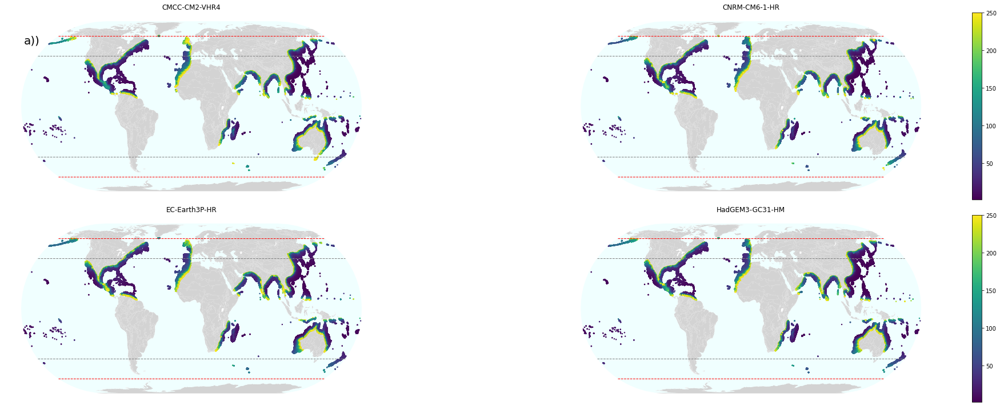

In [9]:
plot_future_frequency_maps('TC1', freqs_ecoreg_dic, ecoreg_atlantic, ocean_atlantic, label='a)', to_file=True)

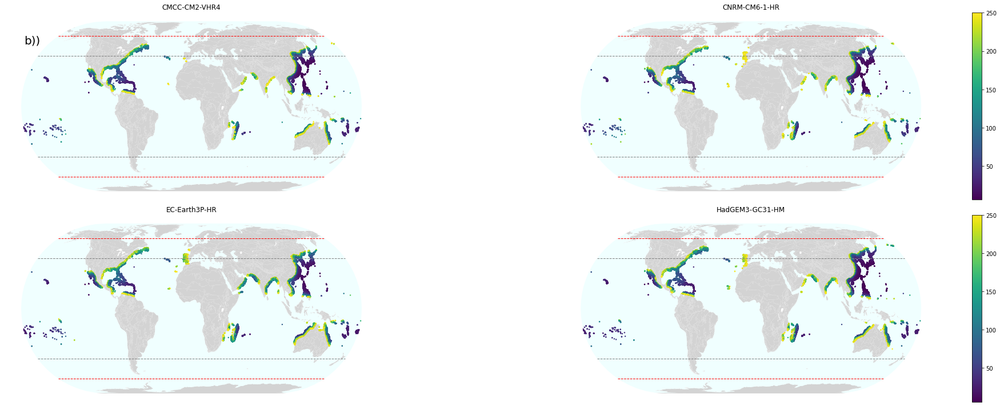

In [10]:
plot_future_frequency_maps('TC2', freqs_ecoreg_dic, ecoreg_atlantic, ocean_atlantic, label='b)', to_file=True)

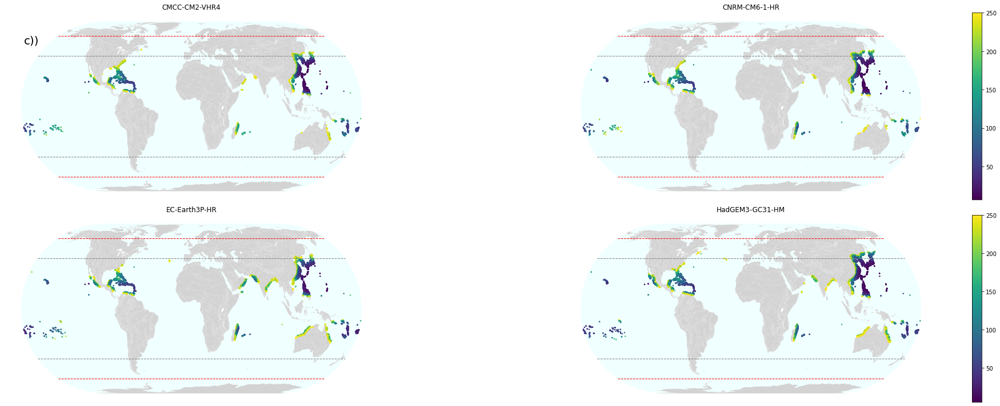

In [11]:
plot_future_frequency_maps('TC3', freqs_ecoreg_dic, ecoreg_atlantic, ocean_atlantic, label='c)', to_file=True)

In [7]:
freqs_ecoreg = get_freqs_ecoreg_gdf('present', '')

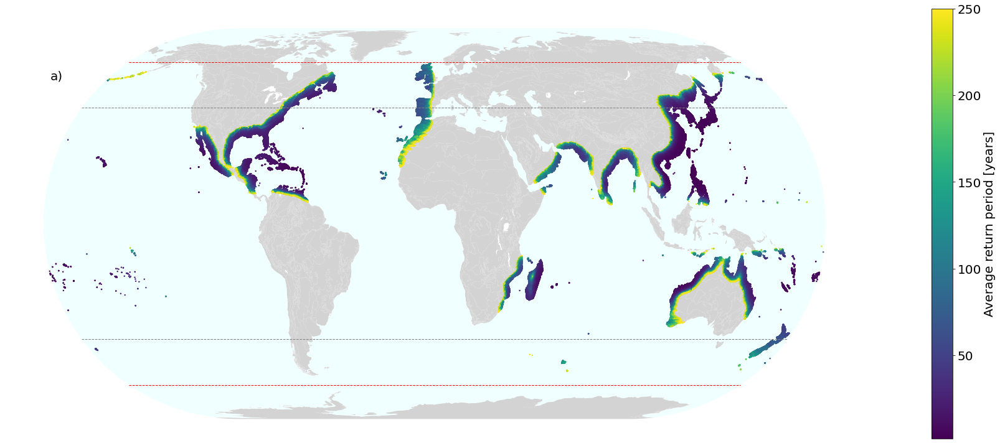

In [29]:
plot_present_frequency_maps(
    'TC1',
    freqs_ecoreg,
    oceans_plot_atlantic=ocean_atlantic,
    ecoreg_geom_plot_atlantic=ecoreg_atlantic,
    label='a',
    to_file=True
)

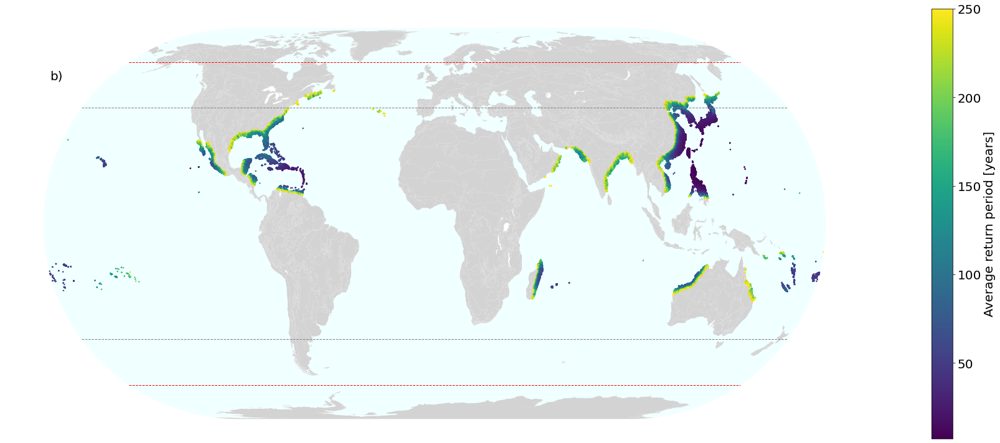

In [30]:
plot_present_frequency_maps(
    'TC2',
    freqs_ecoreg,
    oceans_plot_atlantic=ocean_atlantic,
    ecoreg_geom_plot_atlantic=ecoreg_atlantic,
    label='b',
    to_file=True
)

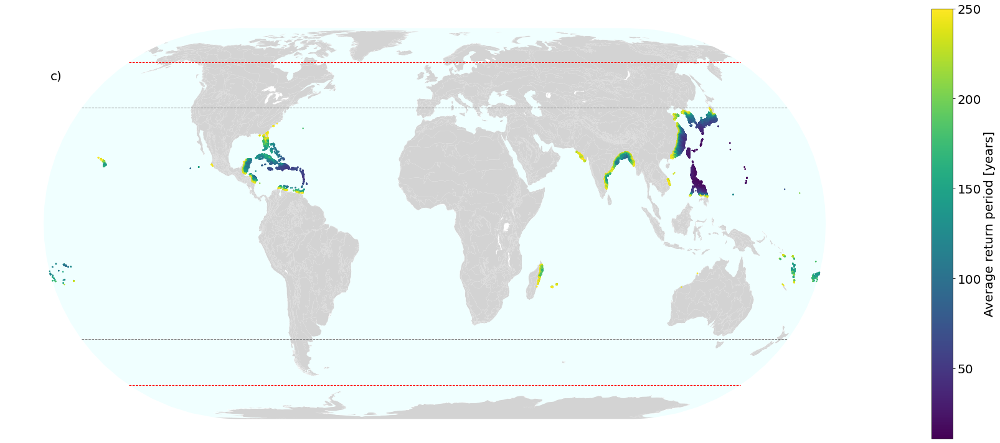

In [31]:
plot_present_frequency_maps(
    'TC3',
    freqs_ecoreg,
    oceans_plot_atlantic=ocean_atlantic,
    ecoreg_geom_plot_atlantic=ecoreg_atlantic,
    label='c',
    to_file=True
)

## Ecoregions stats 

In [32]:
from result_methods import vulnerability_nexus
min_prob = 1/20
max_rp=1/250
nexus_present = vulnerability_nexus(
    min_prob=min_prob,
    time='present',
    gcm='',
    to_file=False
)

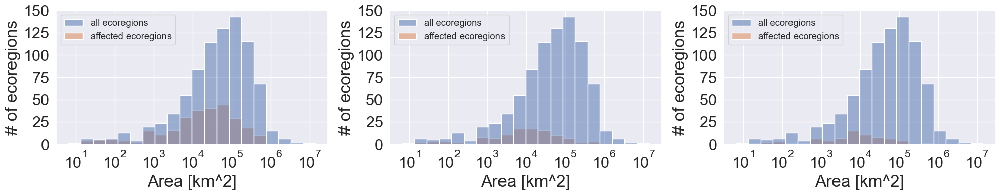

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns
from helper_methods import TC_CAT
fig, axes = plt.subplots(ncols=3, figsize = (20, 4))
sns.set(font_scale = 1.2)
for ax, cat in zip(axes, TC_CAT):
    gdf_affected_ecoreg['affected'] = 0
    gdf_affected_ecoreg['affected'][(nexus_present[cat]['mean'] > 1/250).values] = 1
    sns.histplot(
        {
            'all ecoregions' : gdf_affected_ecoreg['SHAPE_AREA'].values,
            'affected ecoregions': gdf_affected_ecoreg[gdf_affected_ecoreg['affected']==1]['SHAPE_AREA'].values
        },
        log_scale=10, bins=20, ax=ax
    )
    ax.set_xlabel('Area [km^2]');
    ax.set_ylabel('# of ecoregions');
fig.tight_layout()

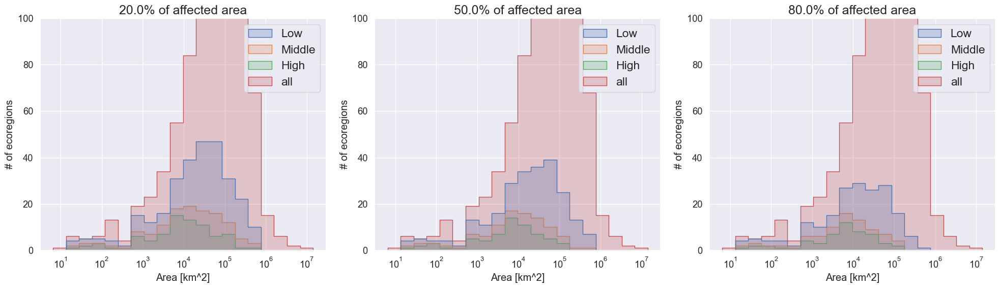

In [34]:
from helper_methods import TC_CAT
from plot_vars import TC_CAT_TO_NAMES
from result_methods import RESULTS
import matplotlib.pyplot as plt
import seaborn as sns
thres = 1/250
QUANTS = [0.8, 0.5, 0.2]
fig, axes = plt.subplots(ncols=3, figsize=(20,6))
sns.set(font_scale = 1.5)
for m, (ax, quant) in enumerate(zip(axes, QUANTS)):
    plot_area = {}
    for cat in TC_CAT:
        gdf_affected_ecoreg['affected'] = 0
        gdf_affected_ecoreg['affected'][(nexus_present[cat][str(quant)] > 1/250).values] = 1
        plot_area[TC_CAT_TO_NAMES[cat]] = gdf_affected_ecoreg[gdf_affected_ecoreg['affected']==1]['SHAPE_AREA'].values 
    plot_area['all'] = gdf_affected_ecoreg['SHAPE_AREA'] 
    sns.histplot(plot_area, log_scale=10, ax=ax, bins=20, element='step')
    ax.set_title(f'{np.round((1-quant) * 100, 1)}% of affected area')
    ax.set_xlabel('Area [km^2]');
    ax.set_ylabel('# of ecoregions');
    ax.set_ylim([0, 100])
fig.tight_layout()
fig.savefig(RESULTS / 'Affected_area_plot.png', dpi=300)

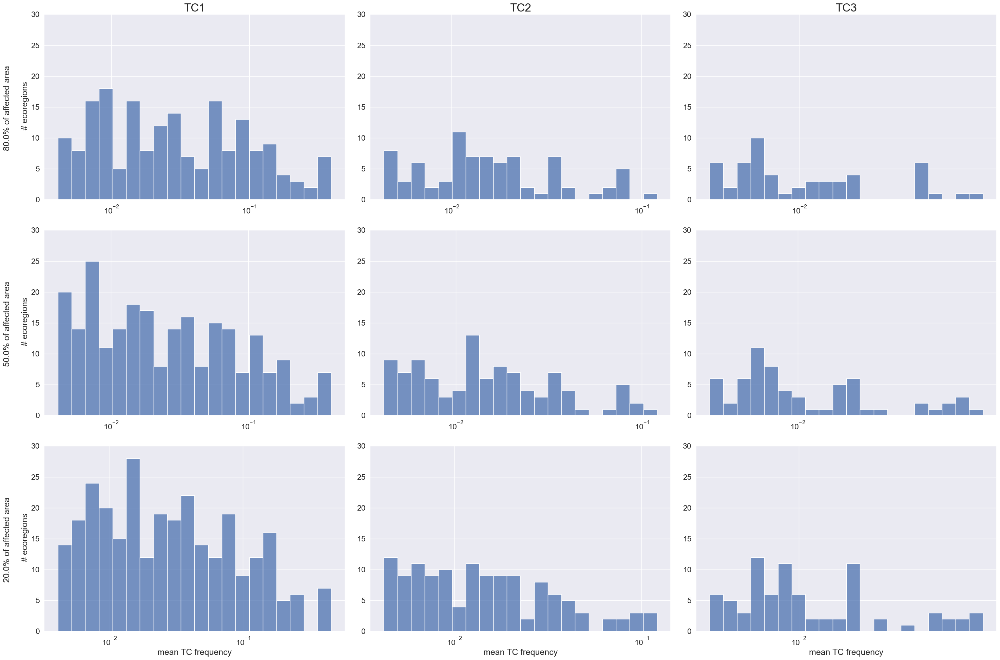

In [35]:
from helper_methods import TC_CAT
import matplotlib.pyplot as plt
import seaborn as sns
thres = 1/250
QUANTS = [0.2, 0.5, 0.8]
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(30,20))
sns.set(font_scale = 2)
for m, (row_axes, quant) in enumerate(zip(axes, QUANTS)):
    for n, (ax, cat) in enumerate(zip(row_axes, TC_CAT)):
        freqs = nexus_present[cat][str(quant)].values
        sns.histplot(freqs[freqs > thres], log_scale=10, ax=ax, bins=20)
        ax.set_ylim([0, 30])
        if m==0:
            ax.set_title(f'{cat}')
        #if n==2:
        #    ax2 = ax.twinx()
        #    ax2.set_ylabel('# ecoregions')
        ax.set_ylabel('')
        if n==0:
            ax.set_ylabel(f'{np.round((1-quant) * 100, 1)}% of affected area \n \n # ecoregions')
        if m==2:
            ax.set_xlabel('mean TC frequency')
fig.tight_layout()


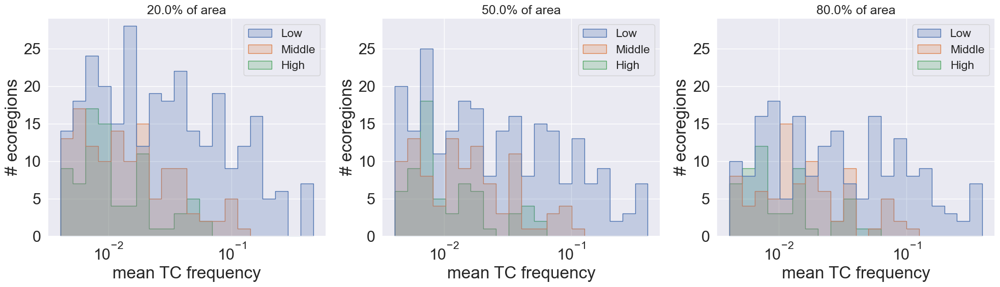

In [36]:
from helper_methods import TC_CAT
import matplotlib.pyplot as plt
import seaborn as sns
thres = 1/250
QUANTS = [0.8, 0.5, 0.2]
fig, axes = plt.subplots(ncols=3, figsize=(20,6))
sns.set(font_scale = 1.5)
for m, (ax, quant) in enumerate(zip(axes, QUANTS)):
    plot_freqs = {}
    for cat in TC_CAT:
        freqs = nexus_present[cat][str(quant)].values
        plot_freqs[TC_CAT_TO_NAMES[cat]] = freqs[freqs > thres]
    sns.histplot(plot_freqs, log_scale=10, ax=ax, bins=20, element='step')
    ax.set_title(f'{np.round((1-quant) * 100, 1)}% of area')
    ax.set_ylabel('# ecoregions')
    ax.set_xlabel('mean TC frequency')
    ax.set_ylim([0, 29])
fig.tight_layout()
fig.savefig(RESULTS / 'Frequency_historgram.png', dpi=300)

## Affected regions 

In [37]:
from result_methods import vulnerability_nexus

### Default 1/20 

In [38]:
min_prob = 1/20
nexus_present = vulnerability_nexus(
    min_prob=min_prob,
    time='present',
    gcm='',
    to_file=False
)

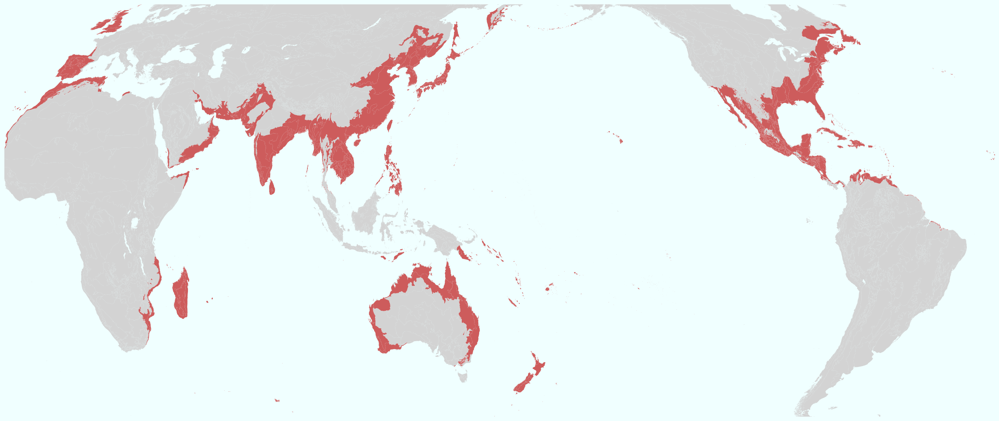

In [39]:
from result_methods import plot_affected_regions
plot_affected_regions(ecoreg_pacific, min_prob, nexus_present, affected_quant='0.8', to_file=True)

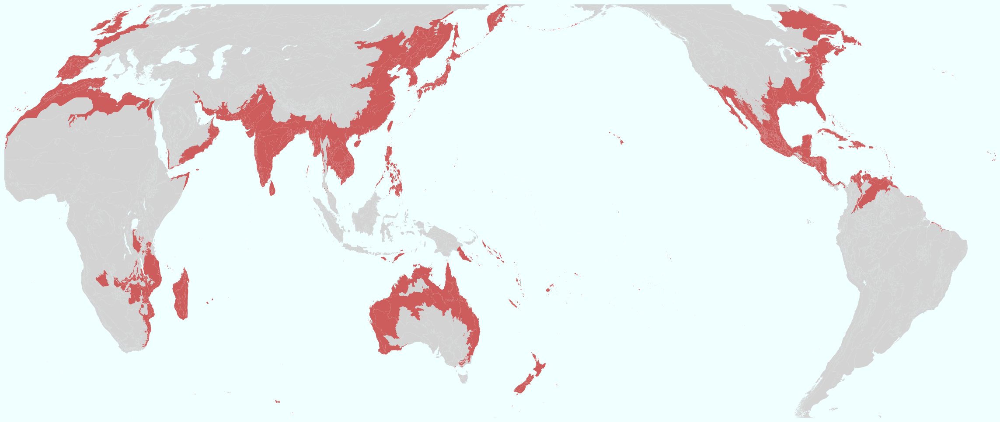

In [40]:
from result_methods import plot_affected_regions
plot_affected_regions(ecoreg_pacific, min_prob, nexus_present, affected_quant='0.95', to_file=True)

### Sensitivity 

0.01 100
0.01 200
0.01 250
0.01 500
0.2 100
0.2 200
0.2 250
0.2 500
0.5 100
0.5 200
0.5 250
0.5 500
0.8 100
0.8 200
0.8 250
0.8 500


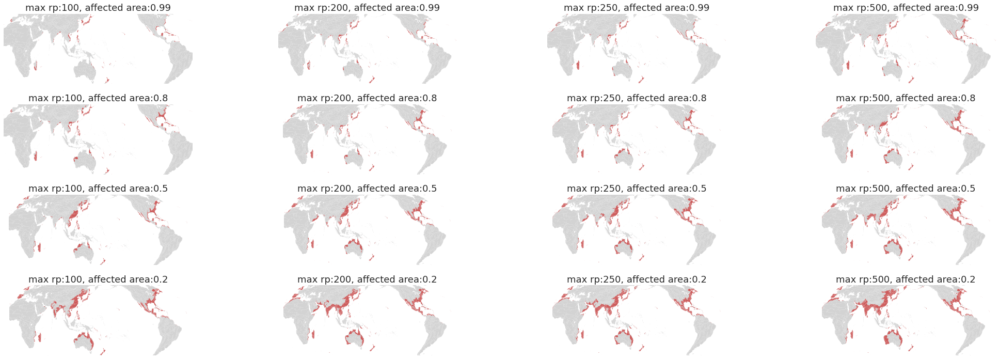

In [185]:
from result_methods import plot_affected_regions_sensitivity
rp_thres = [100, 200, 250, 500]
affected_quants = [0.01, 0.2, 0.5, 0.8]
plot_affected_regions_sensitivity(ecoreg_pacific, rp_thres, affected_quants, to_file=True)

## Vulnerabilities 

### Default 1/20 

In [47]:
from result_methods import vulnerability_plots

In [48]:
min_prob = 1/20
nexus_present = vulnerability_nexus(
    min_prob=min_prob,
    time='present',
    gcm='',
    to_file=False
)

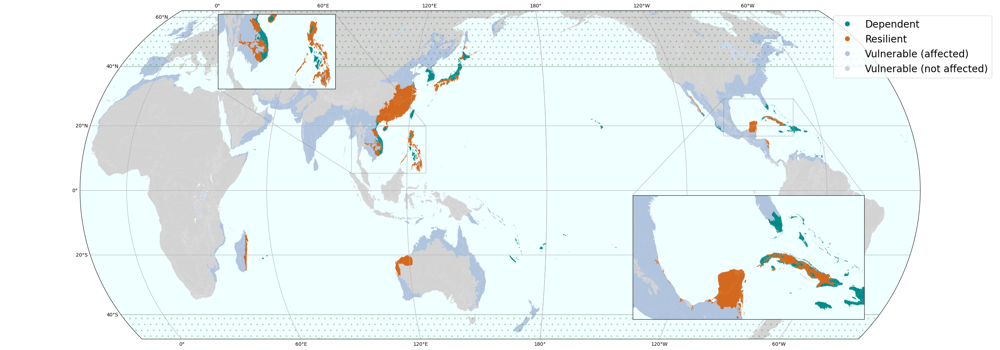

In [145]:
vulnerability_plots(nexus_present, min_prob, ecoreg_pacific, to_file=True)

In [44]:
from result_methods import vulnerability_zoom_plots

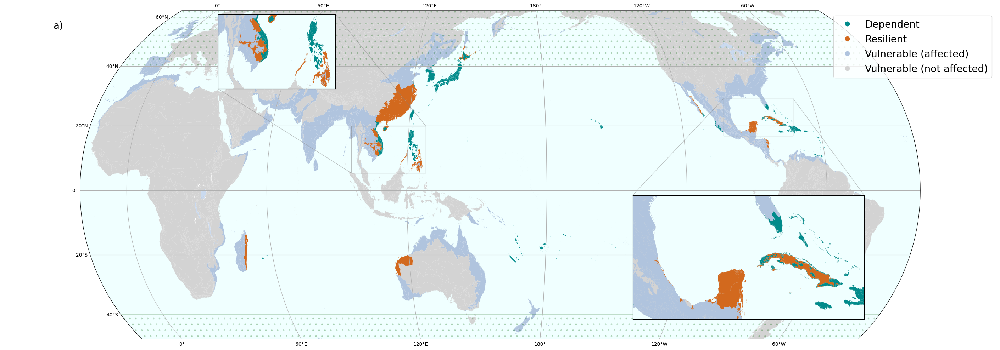

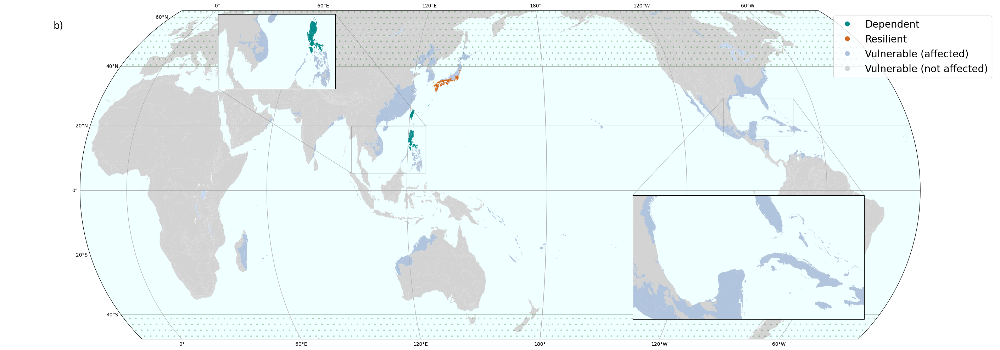

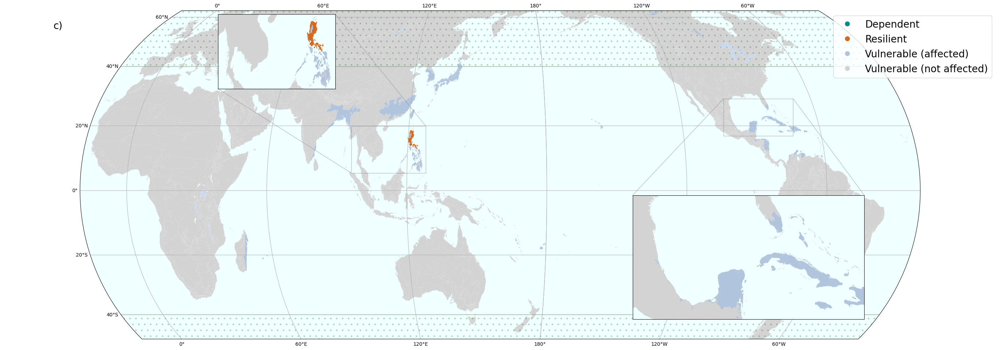

In [165]:
vulnerability_zoom_plots(min_prob, ecoreg_pacific, to_file=True)

### Sensitivity 

all
TC1
TC2
TC3
all
TC1
TC2
TC3
all
TC1
TC2
TC3
all
TC1
TC2
TC3


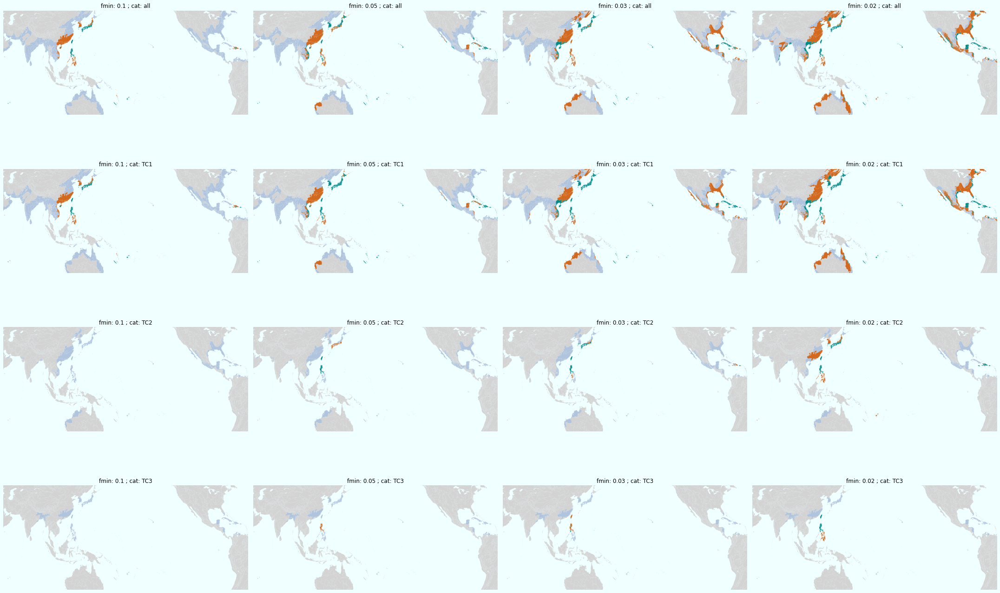

In [90]:
from result_methods import vulnerability_sensitivity_plots
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
min_probs = [1/10, 1/20, 1/30, 1/50]
vulnerability_sensitivity_plots(min_probs, ecoreg_pacific, to_file=True)

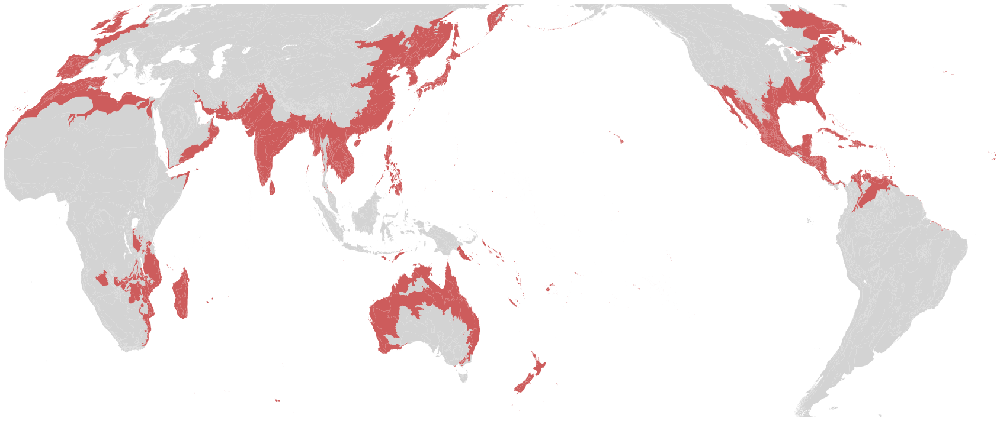

In [184]:
from result_methods import plot_affected_regions
plot_affected_regions(ecoreg_pacific, min_prob, nexus_present, affected_quant='0.95', to_file=True)

## CC 

### Default 1/20 

In [56]:
from result_methods import ecoreg_diff_cc, ecoreg_diff_at_risk, vulnerability_nexus

In [57]:
min_prob = 1/20
max_rp = 250
nexus_present = vulnerability_nexus(
    min_prob=min_prob,
    time='present',
    gcm='',
    to_file=False,
    max_rp=max_rp
)

In [58]:
ecoreg_diff = ecoreg_diff_cc(nexus_present, ecoreg_atlantic, max_rp=max_rp)

/Users/ckropf/Documents/Climada/Ecosystems/Manuscript_TC/Submission_NatClim/Review2/Code/result_methods.py:474: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df = df.applymap(lambda x: clip_df(x, 1/max_rp))
/Users/ckropf/Documents/Climada/Ecosystems/Manuscript_TC/Submission_NatClim/Review2/Code/result_methods.py:474: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df = df.applymap(lambda x: clip_df(x, 1/max_rp))
/Users/ckropf/Documents/Climada/Ecosystems/Manuscript_TC/Submission_NatClim/Review2/Code/result_methods.py:474: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df = df.applymap(lambda x: clip_df(x, 1/max_rp))


In [59]:
ecoreg_at_risk = ecoreg_diff_at_risk(ecoreg_diff)

In [60]:
from result_methods import plot_cc, CCRS_PACIFIC

/Users/ckropf/Documents/Climada/Ecosystems/Manuscript_TC/Submission_NatClim/Review2/Code/result_methods.py:753: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg)


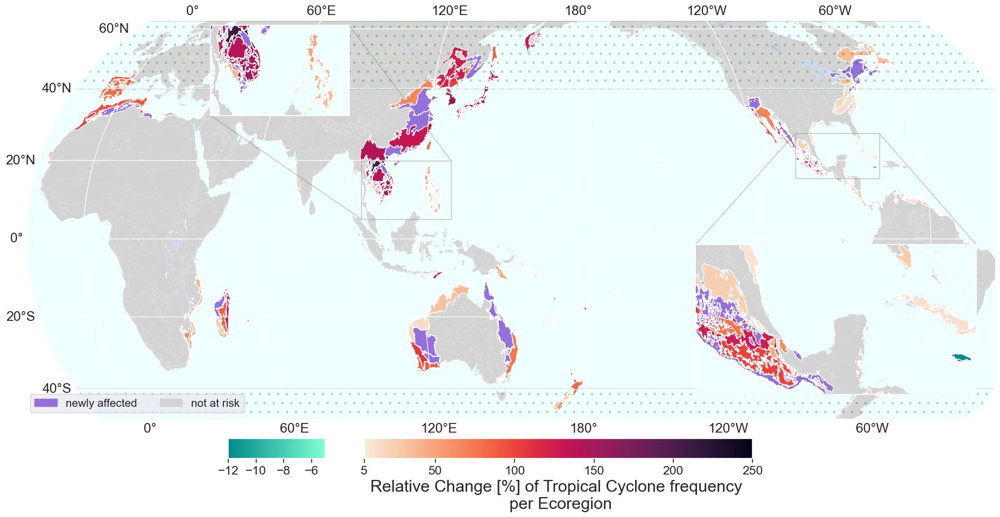

In [61]:
ax = plot_cc(ecoreg_at_risk, min_prob, ecoreg_pacific, threshold_sig_diff=0.1, to_file=True)

### Plots per cat and gcm

/Users/ckropf/Documents/Climada/Ecosystems/Manuscript_TC/Submission_NatClim/Review2/Code/result_methods.py:753: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg)
/Users/ckropf/Documents/Climada/Ecosystems/Manuscript_TC/Submission_NatClim/Review2/Code/result_methods.py:769: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(ax=inset_ax, color =new_affected_color, legend = False)


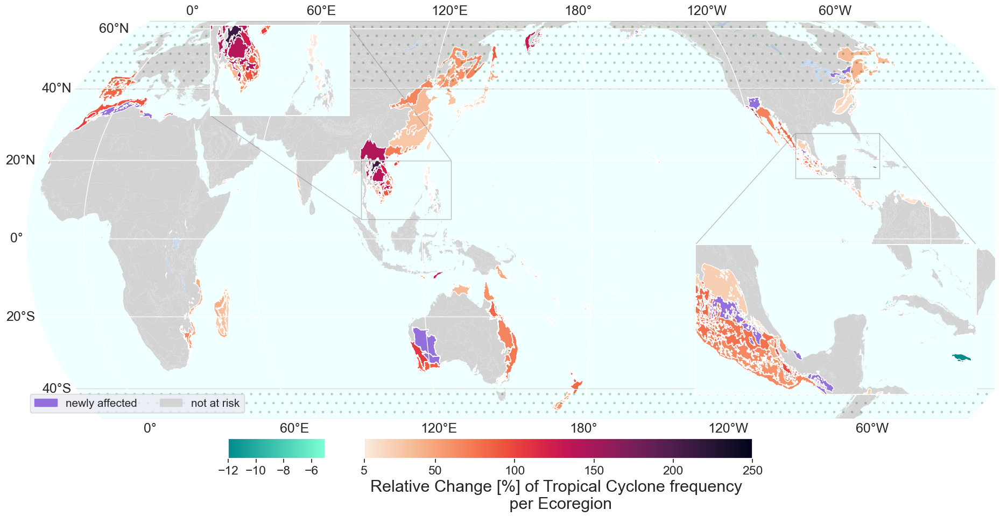

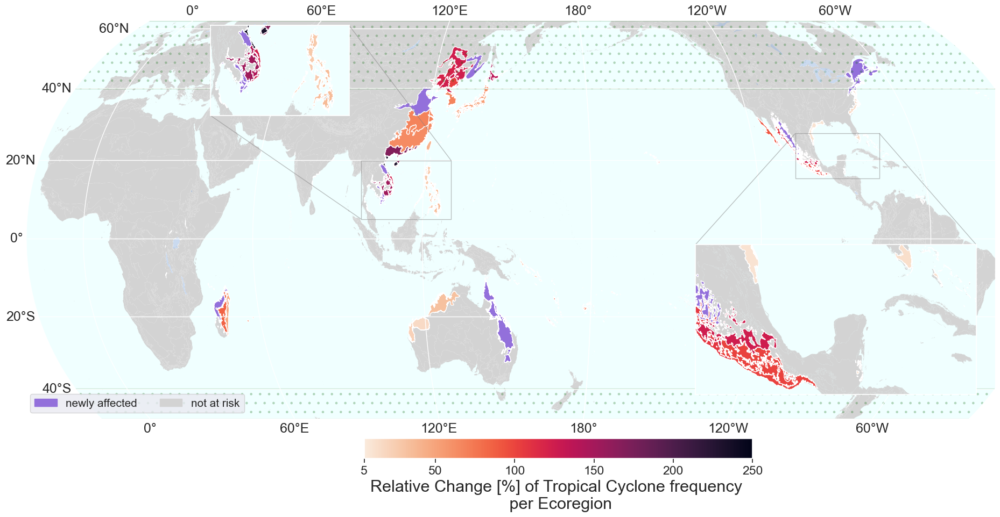

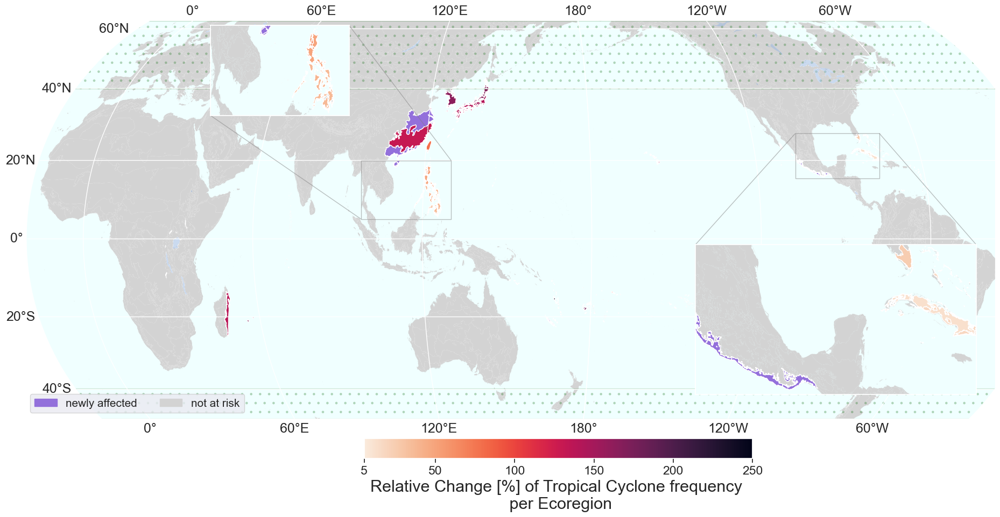

In [63]:
from helper_methods import TC_CAT
for tc_cat in TC_CAT:
    ax = plot_cc(ecoreg_at_risk, min_prob, ecoreg_pacific, threshold_sig_diff=0.1, tc_cat=tc_cat, to_file=True)

/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


CMCC-CM2-VHR4


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


CNRM-CM6-1-HR
EC-Earth3P-HR


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


HadGEM3-GC31-HM


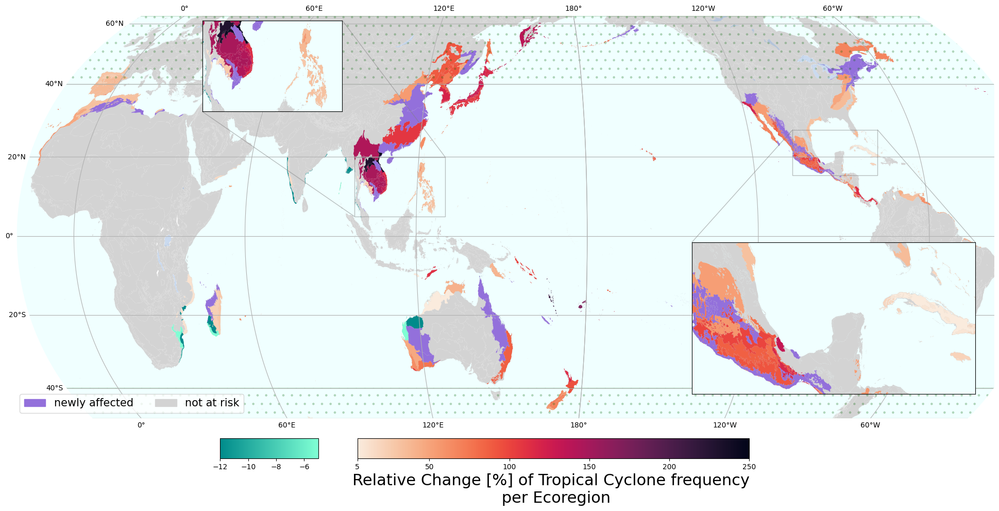

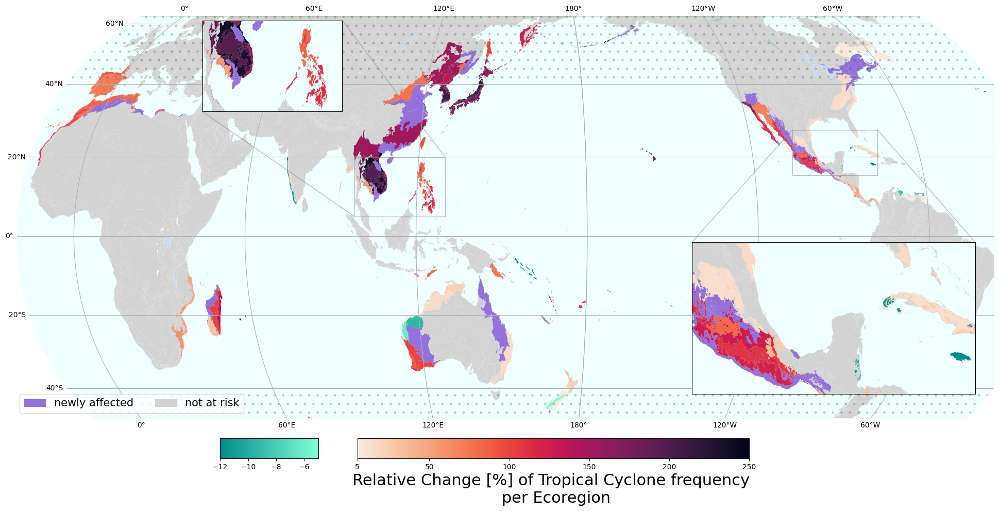

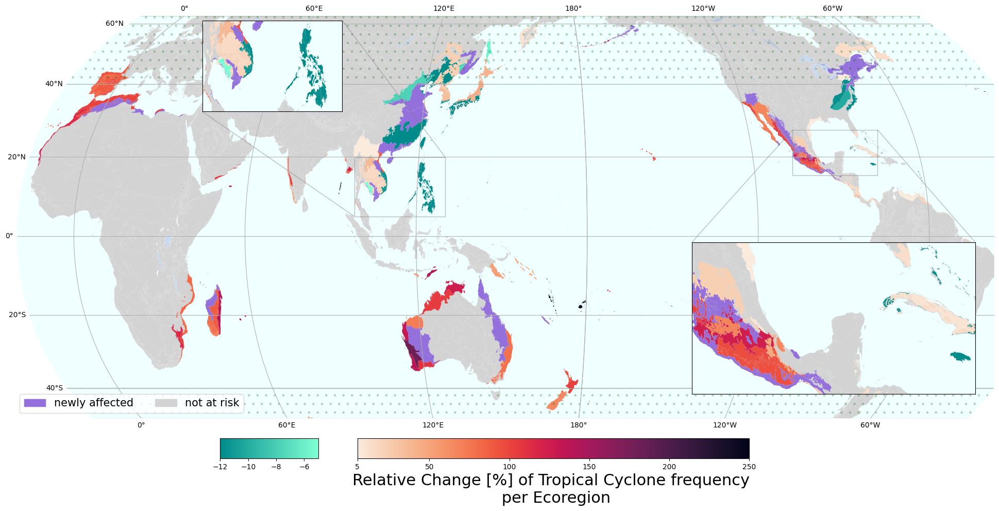

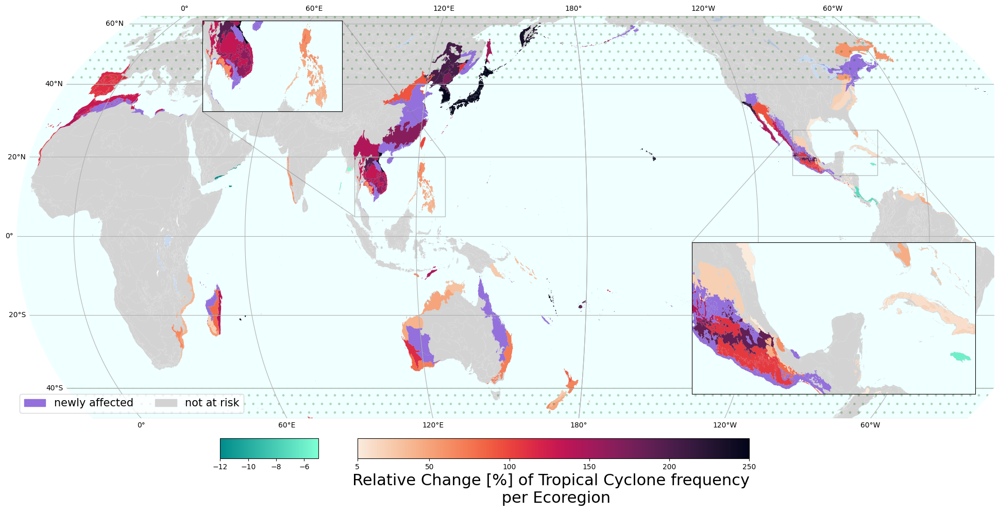

In [196]:
from helper_methods import GCM
from result_methods import plot_cc
for gcm in GCM:
    plot_cc(ecoreg_at_risk, min_prob, ecoreg_pacific, threshold_sig_diff=0.1, vmax=250, model=gcm, to_file=True)
    print(gcm)

#### GCM agreement 

(<Figure size 2160x1440 with 3 Axes>, <AxesSubplot:>)

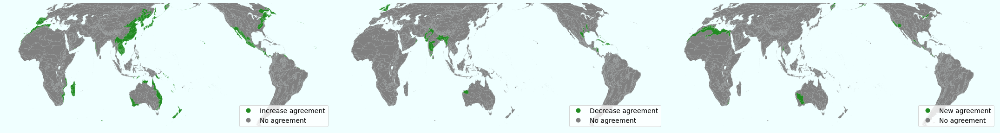

In [556]:
from result_methods import gcm_change_agreement
gcm_change_agreement(ecoreg_atlantic, ecoreg_pacific, agree_ratio = 0.75)

### Sensitivity 

In [166]:
from result_methods import plot_cc_sensitivity

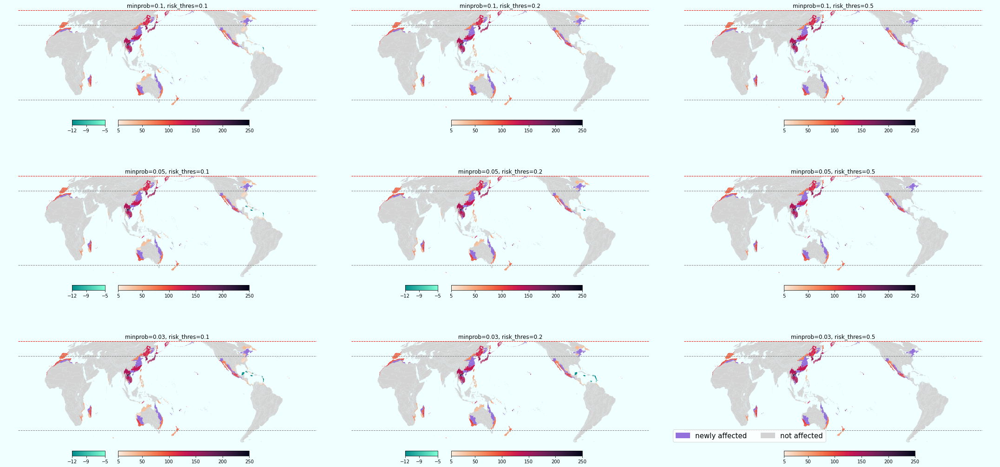

In [75]:
plot_cc_sensitivity(min_probs=[1/10, 1/20, 1/30, 1/50], thresholds_sig_diff=[0.1, 0.2, 0.5], ecoreg_geom_plot=ecoreg_pacific, ecoreg_atlantic=ecoreg_atlantic, to_file=True)

CMCC-CM2-VHR4 0.05
CMCC-CM2-VHR4 0.1
CMCC-CM2-VHR4 0.2
CMCC-CM2-VHR4 0.3
CNRM-CM6-1-HR 0.05


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


CNRM-CM6-1-HR 0.1


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


CNRM-CM6-1-HR 0.2


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


CNRM-CM6-1-HR 0.3


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


EC-Earth3P-HR 0.05
EC-Earth3P-HR 0.1
EC-Earth3P-HR 0.2
EC-Earth3P-HR 0.3
HadGEM3-GC31-HM 0.05


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


HadGEM3-GC31-HM 0.1


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


HadGEM3-GC31-HM 0.2
HadGEM3-GC31-HM 0.3
Median 0.05


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


Median 0.1


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


Median 0.2


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


Median 0.3


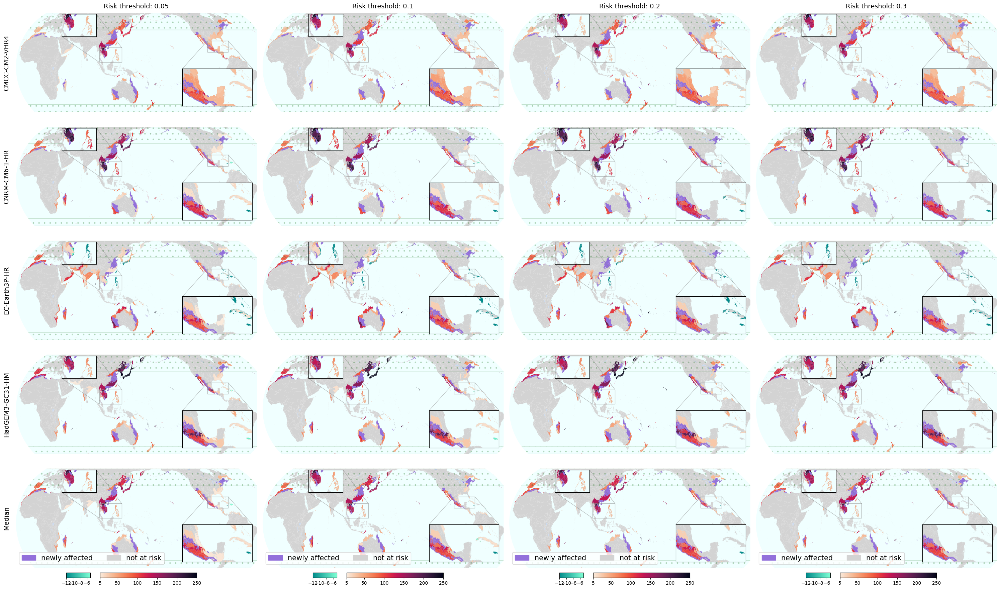

In [197]:
from Make_Freq_Maps.helper_methods import GCM
from result_methods import plot_cc_gcm_sensitivity
plot_cc_gcm_sensitivity(
    thresholds_sig_diff=[0.05, 0.1, 0.2, 0.3], models=GCM + ['Median'],
    ecoreg_geom_plot=ecoreg_pacific, ecoreg_atlantic=ecoreg_atlantic, to_file=True, gridlines=False
)

CMCC-CM2-VHR4 0.05
CMCC-CM2-VHR4 0.3
CNRM-CM6-1-HR 0.05


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


CNRM-CM6-1-HR 0.3


/cluster/work/climate/ckropf/EcosystemsTC/STORM/result_methods.py:839: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  df_subset.plot(column = col, cmap=CMAP_NEG, ax=inset_ax, norm=norm_neg, edgecolor='darkcyan')


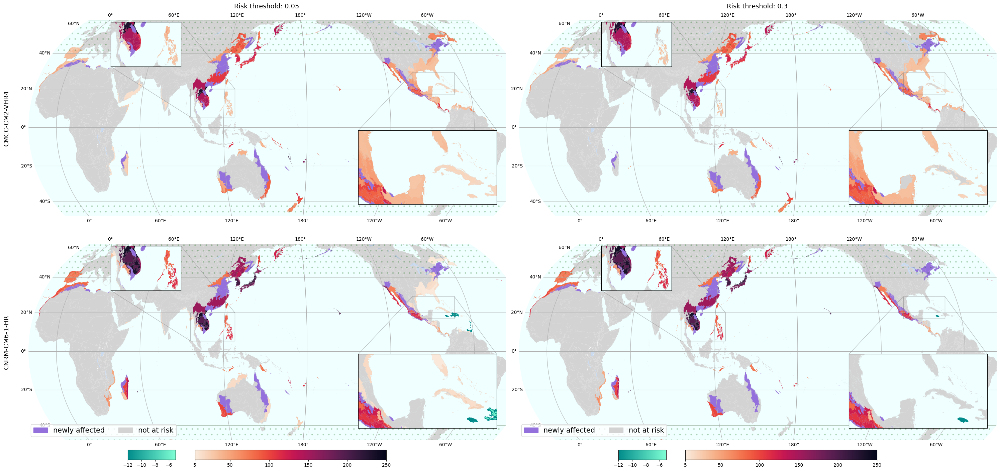

In [167]:
from helper_methods import GCM
from result_methods import plot_cc_gcm_sensitivity
plot_cc_gcm_sensitivity(
    thresholds_sig_diff=[0.05, 0.3], models=GCM[0:2],
    ecoreg_geom_plot=ecoreg_pacific, ecoreg_atlantic=ecoreg_atlantic, to_file=False, gridlines=True
)

## Sensitivity indices 

In [199]:
import SALib
SALib.__version__

'1.4.5'

In [200]:
from result_methods import ecoreg_diff_cc, ecoreg_diff_at_risk, vulnerability_nexus, GCM
import numpy as np

In [201]:
min_prob = 1/20
max_rp = 250
model = GCM[0]
res_quant = 0.8
dep_quant = 0.2
threshold = 0.1
nexus_present = vulnerability_nexus(
    min_prob=min_prob,
    time='present',
    gcm='',
    to_file=False,
    max_rp=max_rp
)

In [202]:
ecoreg_diff = ecoreg_diff_cc(nexus_present, ecoreg_atlantic, max_rp=max_rp, resilience_quant=res_quant, dependence_quant=dep_quant)

In [203]:
ecoreg_at_risk = ecoreg_diff_at_risk(ecoreg_diff,thresholds=np.array([threshold]), model=model)

In [204]:
from result_methods import uncertainty_pipeline, get_output_values

In [205]:
from SALib import ProblemSpec

input_names = ['minprob', 'maxrp', 'model', 'resquant', 'depquant', 'thres']
version = 2
bounds = [[1/50, 1/10], [200, 300], [0, 5], [0.7, 0.9], [0.1, 0.3], [0.05, 0.3]]
out_names = list(get_output_values(ecoreg_at_risk, nexus_present, model, threshold, affected_quant=res_quant).keys())

sp = ProblemSpec({
        "names": input_names,
        "groups": None,
        "bounds": bounds,
        "outputs": out_names,
    })

N = 2**10
sp.sample_saltelli(N, calc_second_order=False)
X = sp.samples


In [17]:
X.shape

(8192, 6)

In [206]:
Y = np.load(f'./Results/uncertainty_n{N}_v{version}.npy')
sp.set_results(Y);

In [19]:
len(out_names)

24

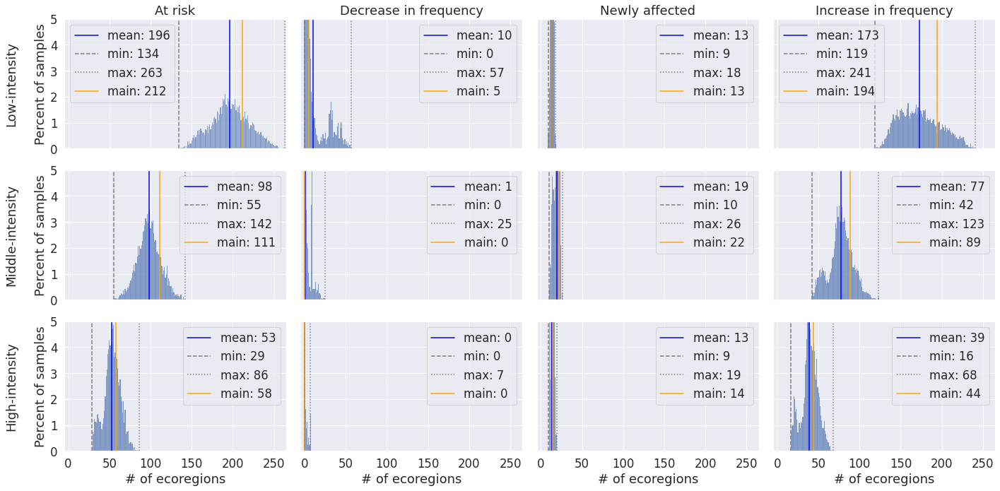

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a figure for all the plots
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(20, 10), sharex=True, sharey=True)
main_values = uncertainty_pipeline(1/20, 250, 4, 0.8, 0.2, 0.1, ecoreg_atlantic=ecoreg_atlantic)
stat = 'percent'
sns.set(font_scale=1.5)
for n, ax in enumerate(axes.flatten()):
    data = Y[:,n]
    sns.histplot(data, ax=ax, stat=stat, binwidth=1, discrete=True)  # Use the current axis
    xmin, xmax, mean = np.min(data), np.max(data), int(np.mean(data))
    ax.axvline(x=mean, color='blue', linestyle='-', label=f'mean: {int(mean)}')
    ax.axvline(x=xmin, color='gray', linestyle='dashed', label=f'min: {int(xmin)}')
    ax.axvline(x=xmax, color='gray', linestyle='dotted', label=f'max: {int(xmax)}')
    #median_model_samples = np.argwhere(X[:,2]>=4).flatten()
    #sns.histplot(data[median_model_samples], color='orange', ax=ax, stat=stat, discrete=True)
    ax.axvline(x=main_values[n], color='orange', linestyle='-', label=f'main: {int(main_values[n])}')
    # Set xticks and labels
    #ax.set_xticks([*ax.get_xticks(), mean])  # Add new tick to existing ticks
    #ax.set_xticklabels([*ax.get_xticklabels(), str(int(mean))])  # Add label for new tick
    ax.legend()
    ax.set_xlim([-5, 265])
    ax.set_ylim([0, 5])
    ax.set_ylabel('')
    ax.set_title('')
    if n == 0:
        ax.set_ylabel('Low-intensity\n\nPercent of samples')
    if n == 4:
        ax.set_ylabel('Middle-intensity\n\nPercent of samples')
    if n == 8:
        ax.set_ylabel('High-intensity\n\nPercent of samples')
    if n == 0:
        ax.set_title('At risk')
    if n == 1:
        ax.set_title('Decrease in frequency')
    if n == 2:
        ax.set_title('Newly affected')
    if n == 3:
        ax.set_title('Increase in frequency')
    ax.set_xlabel('# of ecoregions')
# Adjust layout (optional)
plt.tight_layout()
plt.show()
fig.savefig(f'./Results/Uncertainty_CC_nb_of_regions_N{N}_v{version}.png', dpi=600)

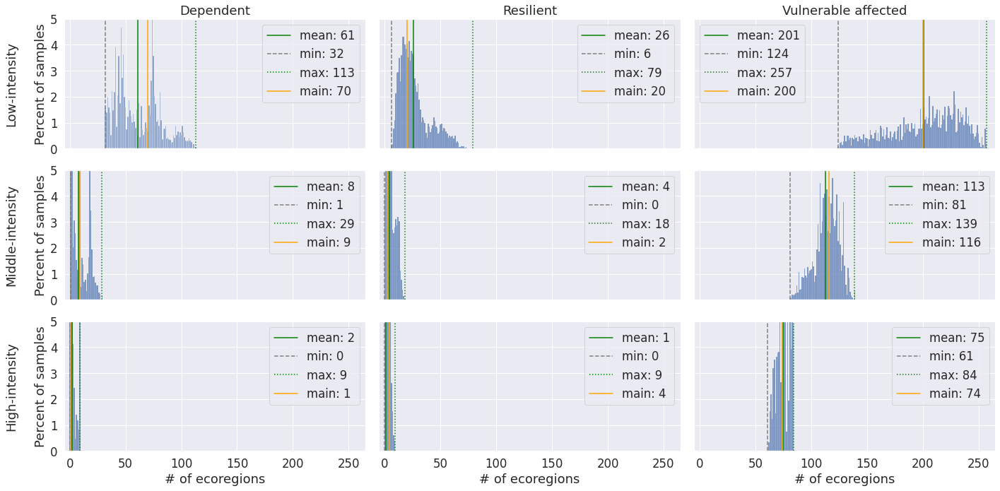

In [63]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a figure for all the plots
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(20, 10), sharex=True, sharey=True)
main_values = uncertainty_pipeline(1/20, 250, 4, 0.8, 0.2, 0.1, ecoreg_atlantic=ecoreg_atlantic)
sns.set(font_scale=1.5)

for n, ax in enumerate(axes.flatten()):
    if n >= 2:
        n = n + 1
    if n >= 6:
        n = n + 1
    if n >= 10:
        n = n + 1
    data = Y[:,n+12]
    sns.histplot(data, ax=ax, stat='percent', discrete=True)  # Use the current axis
    ax.set_title(out_names[n+12])
    xmin, xmax, mean = np.min(data), np.max(data), int(np.mean(data))
    ax.axvline(x=mean, color='green', linestyle='-', label=f'mean: {int(mean)}')
    ax.axvline(x=xmin, color='gray', linestyle='dashed', label=f'min: {int(xmin)}')
    ax.axvline(x=xmax, color='green', linestyle='dotted', label=f'max: {int(xmax)}')
    ax.axvline(x=main_values[n+12], color='orange', linestyle='-', label=f'main: {int(main_values[n+12])}')

    # Set xticks and labels
    #ax.set_xticks([*ax.get_xticks(), mean])  # Add new tick to existing ticks
    #ax.set_xticklabels([*ax.get_xticklabels(), str(int(mean))])  # Add label for new tick
    ax.legend()

    ax.set_xlim([-5, 265])
    if n in [2, 6, 10]:
        ax.set_xlim([700, 800])
    ax.set_ylim([0, 5])
    ax.set_ylabel('')
    ax.set_title('')
    if n == 0:
        ax.set_ylabel('Low-intensity\n\nPercent of samples')
    if n == 4:
        ax.set_ylabel('Middle-intensity\n\nPercent of samples')
    if n == 8:
        ax.set_ylabel('High-intensity\n\nPercent of samples')
    if n == 0:
        ax.set_title('Dependent')
    if n == 1:
        ax.set_title('Resilient')
    if n == 2:
        ax.set_title('Not affected')
    if n == 3:
        ax.set_title('Vulnerable affected')
    ax.set_xlabel('# of ecoregions')
    
# Adjust layout (optional)
plt.tight_layout()
plt.show()
fig.savefig(f'./Results/Uncertainty_vulnerability_nb_of_regions_N{N}_v{version}.png', dpi=600)

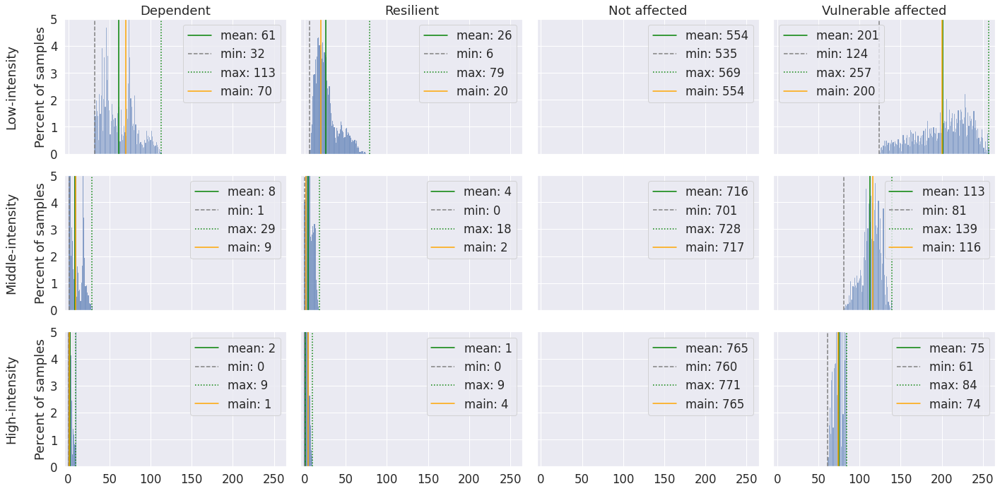

In [46]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a figure for all the plots
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(20, 10), sharex=True, sharey=True)
main_values = uncertainty_pipeline(1/20, 250, 4, 0.8, 0.2, 0.1, ecoreg_atlantic=ecoreg_atlantic)
sns.set(font_scale=1.5)

for n, ax in enumerate(axes.flatten()):
    data = Y[:,n+12]
    sns.histplot(data, ax=ax, stat='percent', discrete=True)  # Use the current axis
    ax.set_title(out_names[n+12])
    xmin, xmax, mean = np.min(data), np.max(data), int(np.mean(data))
    ax.axvline(x=mean, color='green', linestyle='-', label=f'mean: {int(mean)}')
    ax.axvline(x=xmin, color='gray', linestyle='dashed', label=f'min: {int(xmin)}')
    ax.axvline(x=xmax, color='green', linestyle='dotted', label=f'max: {int(xmax)}')
    ax.axvline(x=main_values[n+12], color='orange', linestyle='-', label=f'main: {int(main_values[n+12])}')

    # Set xticks and labels
    #ax.set_xticks([*ax.get_xticks(), mean])  # Add new tick to existing ticks
    #ax.set_xticklabels([*ax.get_xticklabels(), str(int(mean))])  # Add label for new tick
    ax.legend()

    ax.set_xlim([-5, 265])
    if n in [2, 6, 10]:
        ax.set_xlim([700, 800])
    ax.set_ylim([0, 5])
    ax.set_ylabel('')
    ax.set_title('')
    if n == 0:
        ax.set_ylabel('Low-intensity\n\nPercent of samples')
    if n == 4:
        ax.set_ylabel('Middle-intensity\n\nPercent of samples')
    if n == 8:
        ax.set_ylabel('High-intensity\n\nPercent of samples')
    if n == 0:
        ax.set_title('Dependent')
    if n == 1:
        ax.set_title('Resilient')
    if n == 2:
        ax.set_title('Not affected')
    if n == 3:
        ax.set_title('Vulnerable affected')
    ax.set_xlabel('# of ecoregions')
    
# Adjust layout (optional)
plt.tight_layout()
plt.show()
fig.savefig(f'./Results/Uncertainty_vulnerability_nb_of_regions_N{N}_v{version}.png', dpi=600)

In [207]:
sp.analyze_sobol(calc_second_order=False);

In [140]:
print(sp)

Samples:
	6 parameters: ['minprob', 'maxrp', 'model', 'resquant', 'depquant', 'thres']
	8192 evaluations 

Outputs:
	24 outputs: ['Low-intensity at risk', 'Low-intensity decrease', 'Low-intensity new', 'Low-intensity increase', 'Middle-intensity at risk', 'Middle-intensity decrease', 'Middle-intensity new', 'Middle-intensity increase', 'High-intensity at risk', 'High-intensity decrease', 'High-intensity new', 'High-intensity increase', 'Low-intensity dependent', 'Low-intensity resilient', 'Low-intensity not affected', 'Low-intensity affected vulnerable', 'Middle-intensity dependent', 'Middle-intensity resilient', 'Middle-intensity not affected', 'Middle-intensity affected vulnerable', 'High-intensity dependent', 'High-intensity resilient', 'High-intensity not affected', 'High-intensity affected vulnerable']
	8192 evaluations 

Analysis:
Low-intensity at risk:
                ST   ST_conf
minprob   0.033618  0.005012
maxrp     0.041643  0.004083
model     0.399307  0.028117
resquant  0.

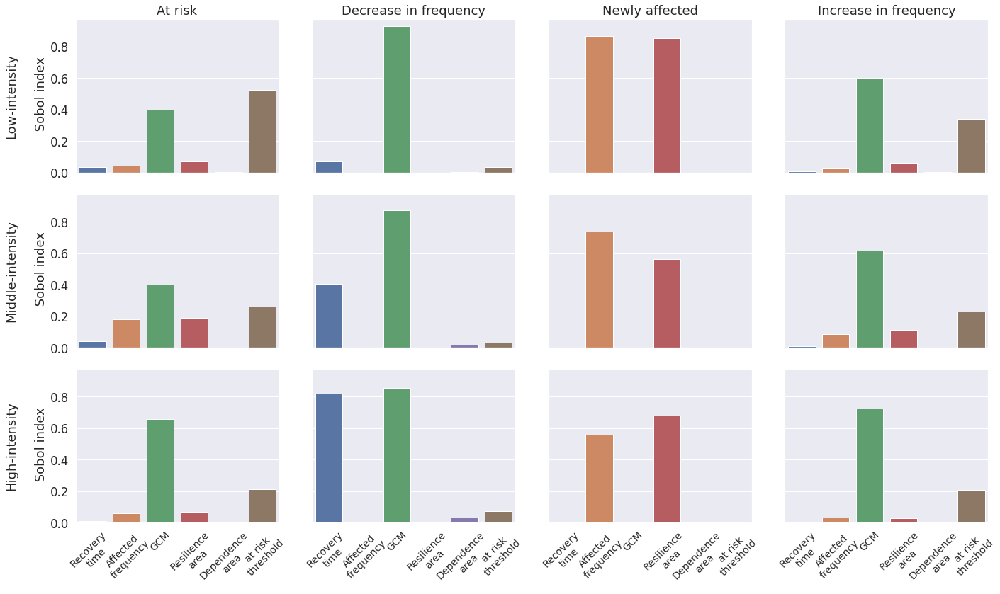

In [74]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a figure for all the plots
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(20, 12), sharex=True, sharey=True)
sns.set(font_scale=1.5)


df_list = sp.to_df()

x_names = ['Recovery\ntime', 'Affected\nfrequency', 'GCM', 'Resilience\narea', 'Dependence\narea', 'at risk\nthreshold']

for n, ax in enumerate(axes.flatten()):
    s_list = df_list[n]
    st = s_list[0]['ST']
    sns.barplot(x=x_names, y=st.values, ax=ax)  # Use the current axis
    #ax.set_title(out_names[n])
    ax.set_xticklabels(x_names,rotation=45, fontsize=14)
    if n == 0:
        ax.set_ylabel('Low-intensity\n\n Sobol index')
    if n == 4:
        ax.set_ylabel('Middle-intensity\n\n Sobol index')
    if n == 8:
        ax.set_ylabel('High-intensity\n\n Sobol index')
    if n == 0:
        ax.set_title('At risk')
    if n == 1:
        ax.set_title('Decrease in frequency')
    if n == 2:
        ax.set_title('Newly affected')
    if n == 3:
        ax.set_title('Increase in frequency')
# Adjust layout (optional)
#fig.suptitle('Total order sensivities')
plt.tight_layout()
plt.show()
fig.savefig(f'./Results/Sensitivity_CC_nb_of_regions_N{N}_v{version}.png', dpi=600)

In [133]:
list(zip(*sp.to_df()))[0][]

,ST,ST_conf
minprob,0.860340,0.368579
maxrp,0.000000,0.000000
model,0.767234,0.334081
resquant,0.000000,0.000000
depquant,0.017905,0.012534
thres,0.121755,0.080426


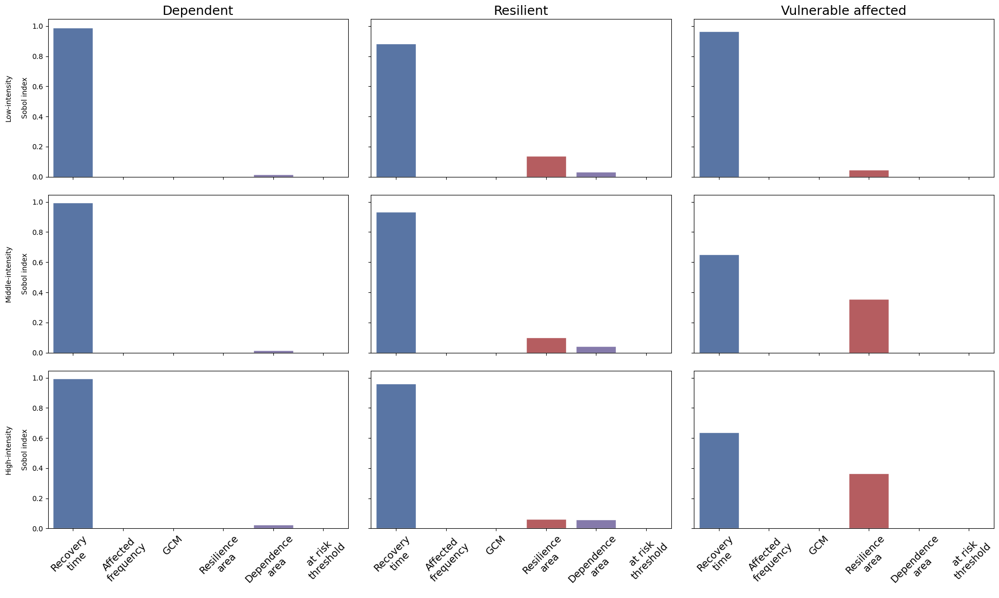

In [210]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a figure for all the plots
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(20, 12), sharex=True, sharey=True)
sns.set(font_scale=1.5)


df_list = sp.to_df()

x_names = ['Recovery\ntime', 'Affected\nfrequency', 'GCM', 'Resilience\narea', 'Dependence\narea', 'at risk\nthreshold']

for n, ax in enumerate(axes.flatten()):
    if n >= 2:
        n = n + 1
    if n >= 6:
        n = n + 1
    if n >= 10:
        n = n + 1
    s_list = df_list[n+12]
    st = s_list[0]['ST']
    sns.barplot(x=x_names, y=st.values, ax=ax)  # Use the current axis
    #ax.set_title(out_names[n+12])
    ax.set_xticklabels(x_names,rotation=45, fontsize=14)
    if n == 0:
        ax.set_ylabel('Low-intensity\n\nSobol index')
    if n == 4:
        ax.set_ylabel('Middle-intensity\n\nSobol index')
    if n == 8:
        ax.set_ylabel('High-intensity\n\nSobol index')
    if n == 0:
        ax.set_title('Dependent')
    if n == 1:
        ax.set_title('Resilient')
    if n == 2:
        ax.set_title('Not affected')
    if n == 3:
        ax.set_title('Vulnerable affected')
    
# Adjust layout (optional)
#fig.suptitle('Total order sensivities')
plt.tight_layout()
plt.show()
fig.savefig(f'./Results/Sensitivity_vulnerability_nb_of_regions_N{N}_v{version}.png', dpi=600)

# Numbers 

## Values summary 

In [27]:
from result_methods import vulnerability_nexus
import numpy as np
min_prob = 1/20
max_rp = 250
nexus_present = vulnerability_nexus(
    min_prob=min_prob,
    time='present',
    gcm='',
    to_file=False,
    max_rp=max_rp
)
quant = '0.8'

In [87]:
from result_methods import make_rp_area_table
rp_table = make_rp_area_table(nexus_present, gdf_affected_ecoreg, quant=quant, max_rp=max_rp)
rp_table

,ECO_NAME,BIOME_NAME,REALM,SHAPE_AREA,V TC1,Rp TC1,V TC2,Rp TC2,V TC3,Rp TC3
0,Adelie Land tundra,Tundra,Antarctica,177.624779,V,0.000000,V,0.0,V,0.0
1,Admiralty Islands lowland rain forests,Tropical & Subtropical Moist Broadleaf Forests,Australasia,2098.541381,V,0.000000,V,0.0,V,0.0
2,Aegean and Western Turkey sclerophyllous and m...,"Mediterranean Forests, Woodlands & Scrub",Palearctic,133558.185743,V,0.000000,V,0.0,V,0.0
3,Afghan Mountains semi-desert,Deserts & Xeric Shrublands,Palearctic,13682.449850,V,0.000000,V,0.0,V,0.0
4,Ahklun and Kilbuck Upland Tundra,Tundra,Nearctic,50824.460415,V,0.000000,V,0.0,V,0.0
...,...,...,...,...,...,...,...,...,...,...
839,Zambezian coastal flooded savanna,Flooded Grasslands & Savannas,Afrotropic,19369.020792,V,80.691692,V,0.0,V,0.0
840,Zambezian evergreen dry forests,Tropical & Subtropical Dry Broadleaf Forests,Afrotropic,31576.894872,V,0.000000,V,0.0,V,0.0
841,Zambezian flooded grasslands,Flooded Grasslands & Savannas,Afrotropic,201935.742349,V,0.000000,V,0.0,V,0.0
842,Zambezian mopane woodlands,"Tropical & Subtropical Grasslands, Savannas & ...",Afrotropic,387595.353482,V,0.000000,V,0.0,V,0.0


In [90]:
rp_table['SHAPE_AREA'].sum() / 1e6

146.43415802851914

In [16]:
# Ecoregions Resilient / Dependent to TC3
import numpy as np
rp_table[np.isin(rp_table['V TC3'], ['D', 'R'])]

,ECO_NAME,BIOME_NAME,REALM,SHAPE_AREA,V TC1,Rp TC1,V TC2,Rp TC2,V TC3,Rp TC3
403,Luzon montane rain forests,Tropical & Subtropical Moist Broadleaf Forests,Indomalayan,8272.779002,D,2.468099,D,11.047366,R,22.575108
404,Luzon rain forests,Tropical & Subtropical Moist Broadleaf Forests,Indomalayan,94876.897278,D,2.622516,D,11.732519,R,22.762803
429,Marianas tropical dry forests,Tropical & Subtropical Dry Broadleaf Forests,Oceania,1032.123860,D,3.583558,D,12.497870,R,17.918228
470,Nansei Islands subtropical evergreen forests,Tropical & Subtropical Moist Broadleaf Forests,Indomalayan,4063.595050,D,2.679601,D,10.592858,R,23.194664
550,Ogasawara subtropical moist forests,Tropical & Subtropical Moist Broadleaf Forests,Oceania,96.247651,D,2.523182,D,8.014426,D,15.673981


In [60]:
from result_methods import get_vulnerability_ecoregions
df = get_vulnerability_ecoregions(nexus_present, affected_quant='0.8')
df

,TC1,TC2,TC3
Vulnerability,,,
D,70,9,1
R,20,2,4
V,554,717,765
VA,200,116,74


In [62]:
# All resilient
df['TC3']['R'] + df['TC2']['R'] + df['TC1']['R']

26

In [63]:
# All dependent
df['TC1']['D'] - df['TC3']['R'] - df['TC2']['R']

64

In [34]:
from result_methods import get_vulnerability_area
df = get_vulnerability_area(nexus_present, gdf_affected_ecoreg, affected_quant='0.8', max_rp=max_rp)
df

,Area TC1,Area TC2,Area TC3
Vulnerability,,,
D,1.10e+06,1.61e+05,9.62e+01
R,2.29e+06,1.39e+05,1.08e+05
V,1.27e+08,1.40e+08,1.44e+08
VA,1.65e+07,5.70e+06,2.55e+06


In [80]:
# All resilient area
RA = (df['Area TC3']['R'] + df['Area TC2']['R'] + df['Area TC1']['R']) 
RA / 1e6

2.535778537302662

In [81]:
# All dependent area
DA = (df['Area TC1']['D'] - df['Area TC3']['R'] - df['Area TC2']['R'])
DA / 1e6

0.8481527680063224

In [82]:
# All vulnerable affected area
VAA = (df['Area TC1']['VA'])
VAA / 1e6

16.548540251816785

In [83]:
# All affected area
VA = (df['Area TC1'][['D', 'R', 'VA']].sum()) 
VA / 1e6

19.93247155712577

In [84]:
# Total dependent or resilient area divided by total area
(DA + RA) / df['Area TC1'].sum()

0.023108893108464073

In [85]:
# Total dependent or resilient TC1 area divided by all affected area
(DA+RA) / df['Area TC1'][['D', 'R', 'VA']].sum()

0.1697697797089917

In [55]:
# The resilience quant return period 0.8 
# of all ecoregions that are affected betweem 0 and 250 years in the future
from result_methods import vulnerability_nexus, ecoreg_diff_cc, GCM
import numpy as np
min_prob = 1/20
max_rp = 250
nexus_present = vulnerability_nexus(
    min_prob=min_prob,
    time='present',
    gcm='',
    to_file=False,
    max_rp=max_rp
)

from result_methods import get_average_rp, nexus_dict_to_affected
quant = '0.8'
np.round(get_average_rp(nexus_dict_to_affected(nexus_present), ecoreg_area_km, quant=quant, max_rp=max_rp), 0)

,TC1,TC2,TC3
V,250.0,250.0,NaN
VA,87.0,102.0,117.0
D,9.0,11.0,17.0
R,13.0,18.0,19.0


In [58]:
# Average over the climate model of the resilience quant return period 0.8 
# of all ecoregions that are affected betweem 0 and 250 years in the future

from result_methods import vulnerability_nexus, ecoreg_diff_cc, GCM
import numpy as np
min_prob = 1/20
max_rp = 250
nexus_present = vulnerability_nexus(
    min_prob=min_prob,
    time='present',
    gcm='',
    to_file=False,
    max_rp=max_rp
)
ecoreg_diff = ecoreg_diff_cc(nexus_present, ecoreg_atlantic, max_rp=max_rp, resilience_quant='0.8', dependence_quant='0.8')

from result_methods import get_average_rp
quant = 'ModelMedian'
#quant = GCM[0]
np.round(get_average_rp(ecoreg_diff, ecoreg_area_km, quant=quant, max_rp=max_rp), 0)

,TC1,TC2,TC3
V,79.0,91.0,110.0
D,7.0,9.0,9.0
R,12.0,13.0,12.0


In [59]:
from result_methods import get_change_frequency
get_change_frequency(ecoreg_atlantic)

,TC category,Median CC CMCC-CM2-VHR4 [%],Median CC CNRM-CM6-1-HR [%],Median CC EC-Earth3P-HR [%],Median CC HadGEM3-GC31-HM [%],Median CC Median [%]
0,TC1,47.4,57.5,59.4,67.4,55.0
1,TC2,73.3,113.7,94.6,113.6,99.4
2,TC3,106.9,153.5,108.2,151.8,148.8


In [71]:
from result_methods import get_at_risk_ecoregions_counts
get_at_risk_ecoregions_counts(ecoreg_pacific)

,Ecoregion Counts TC1,Ecoregion Counts TC2,Ecoregion Counts TC3
increase,194,89,44
new,13,22,14
decrease,5,0,0
total,212,111,58


In [ ]:
from result_methods import get_cc_affected_area
get_cc_affected_area(ecoreg_area_km)

,Ecoregion Area TC1,Ecoregion relative total Area TC1 [%],Ecoregion Area TC2,Ecoregion relative total Area TC2 [%],Ecoregion Area TC3,Ecoregion relative total Area TC3 [%]
increase,1.25e+07,8.50e+00,5.02e+06,3.40e+00,1.69e+06,1.20e+00
new,1.28e+06,9.00e-01,2.28e+06,1.60e+00,7.77e+05,5.00e-01
decrease,2.23e+04,0.00e+00,-0.00e+00,-0.00e+00,-0.00e+00,-0.00e+00
total,1.38e+07,9.40e+00,7.30e+06,5.00e+00,2.47e+06,1.70e+00


## Make tables  

In [49]:
from result_methods import vulnerability_nexus
import numpy as np
min_prob = 1/20
max_rp = 250
nexus_present = vulnerability_nexus(
    min_prob=min_prob,
    time='present',
    gcm='',
    to_file=False,
    max_rp=max_rp
)
quant = '0.8'

In [66]:
from result_methods import make_rp_area_table
rp_table = make_rp_area_table(nexus_present, ecoreg_area_km, affected_quant=quant, max_rp=max_rp)
rp_table

,ECO_NAME,BIOME_NAME,REALM,SHAPE_AREA,V TC1,Rp TC1,V TC2,Rp TC2,V TC3,Rp TC3
0,Adelie Land tundra,Tundra,Antarctica,177.624779,V,0.000000,V,0.0,V,0.0
1,Admiralty Islands lowland rain forests,Tropical & Subtropical Moist Broadleaf Forests,Australasia,2098.541381,V,0.000000,V,0.0,V,0.0
2,Aegean and Western Turkey sclerophyllous and m...,"Mediterranean Forests, Woodlands & Scrub",Palearctic,133558.185743,V,0.000000,V,0.0,V,0.0
3,Afghan Mountains semi-desert,Deserts & Xeric Shrublands,Palearctic,13682.449850,V,0.000000,V,0.0,V,0.0
4,Ahklun and Kilbuck Upland Tundra,Tundra,Nearctic,50824.460415,V,0.000000,V,0.0,V,0.0
...,...,...,...,...,...,...,...,...,...,...
839,Zambezian coastal flooded savanna,Flooded Grasslands & Savannas,Afrotropic,19369.020792,V,68.493151,V,0.0,V,0.0
840,Zambezian evergreen dry forests,Tropical & Subtropical Dry Broadleaf Forests,Afrotropic,31576.894872,V,0.000000,V,0.0,V,0.0
841,Zambezian flooded grasslands,Flooded Grasslands & Savannas,Afrotropic,201935.742349,V,0.000000,V,0.0,V,0.0
842,Zambezian mopane woodlands,"Tropical & Subtropical Grasslands, Savannas & ...",Afrotropic,387595.353482,V,0.000000,V,0.0,V,0.0


In [67]:
ecoreg_area_too_small

,ECO_NAME,OBJECTID,BIOME_NAME,REALM,ECO_ID,SHAPE_AREA,geometry
0,Malpelo Island xeric scrub,415.0,Deserts & Xeric Shrublands,Neotropic,604,7.655598,"POLYGON ((-81.58213 3.99123, -81.57854 3.97784..."
1,St. Peter and St. Paul Rocks,700.0,Deserts & Xeric Shrublands,Neotropic,609,6.042218,"MULTIPOLYGON (((-29.27657 0.91939, -29.27772 0..."
2,Trindade-Martin Vaz Islands tropical forests,840.0,Tropical & Subtropical Moist Broadleaf Forests,Neotropic,509,9.255432,"MULTIPOLYGON (((-29.84472 -20.49806, -29.84889..."


In [87]:
import pandas as pd
table_V = pd.concat([rp_table, ecoreg_area_too_small.drop(columns=['geometry', 'OBJECTID', 'ECO_ID'])])
table_V = table_V.sort_values(['BIOME_NAME', 'V TC1', 'Rp TC1'])
table_V = table_V.round(0)
table_V

,ECO_NAME,BIOME_NAME,REALM,SHAPE_AREA,V TC1,Rp TC1,V TC2,Rp TC2,V TC3,Rp TC3
9,Alaska Peninsula montane taiga,Boreal Forests/Taiga,Nearctic,48877.0,V,0.0,V,0.0,V,0.0
133,Central Canadian Shield forests,Boreal Forests/Taiga,Nearctic,271655.0,V,0.0,V,0.0,V,0.0
178,Cook Inlet taiga,Boreal Forests/Taiga,Nearctic,28042.0,V,0.0,V,0.0,V,0.0
181,Copper Plateau taiga,Boreal Forests/Taiga,Nearctic,17257.0,V,0.0,V,0.0,V,0.0
224,East Siberian taiga,Boreal Forests/Taiga,Palearctic,3922521.0,V,0.0,V,0.0,V,0.0
...,...,...,...,...,...,...,...,...,...,...
826,Wrangel Island Arctic desert,Tundra,Palearctic,7598.0,V,0.0,V,0.0,V,0.0
829,Yamal-Gydan tundra,Tundra,Palearctic,415127.0,V,0.0,V,0.0,V,0.0
699,Southern Indian Ocean Islands tundra,Tundra,Antarctica,8179.0,V,132.0,V,0.0,V,0.0
31,Antipodes Subantarctic Islands tundra,Tundra,Australasia,878.0,V,175.0,V,0.0,V,0.0


In [99]:
def convert_to_int(col):
    try:
        return col.astype(int)
    except ValueError:
        return col  # Return original value if conversion fails

table_V.fillna(0, inplace=True)
table_V = table_V.apply(convert_to_int)
table_V = table_V.replace(0, '-')
table_V

,ECO_NAME,BIOME_NAME,REALM,SHAPE_AREA,V TC1,Rp TC1,V TC2,Rp TC2,V TC3,Rp TC3
9,Alaska Peninsula montane taiga,Boreal Forests/Taiga,Nearctic,48877,V,-,V,-,V,-
133,Central Canadian Shield forests,Boreal Forests/Taiga,Nearctic,271655,V,-,V,-,V,-
178,Cook Inlet taiga,Boreal Forests/Taiga,Nearctic,28042,V,-,V,-,V,-
181,Copper Plateau taiga,Boreal Forests/Taiga,Nearctic,17257,V,-,V,-,V,-
224,East Siberian taiga,Boreal Forests/Taiga,Palearctic,3922521,V,-,V,-,V,-
...,...,...,...,...,...,...,...,...,...,...
826,Wrangel Island Arctic desert,Tundra,Palearctic,7598,V,-,V,-,V,-
829,Yamal-Gydan tundra,Tundra,Palearctic,415127,V,-,V,-,V,-
699,Southern Indian Ocean Islands tundra,Tundra,Antarctica,8179,V,132,V,-,V,-
31,Antipodes Subantarctic Islands tundra,Tundra,Australasia,878,V,175,V,-,V,-


In [100]:
from result_methods import RESULTS
table_V=table_V.rename(columns={
    'V TC1' : 'Vulnerability (Low)',
    'V TC2' : 'Vulnerability (Middle)',
    'V TC3' : 'Vulnerability (High)'
})
table_V=table_V.rename(columns={
    'Rp TC1' : 'Average inverse frequency (Low) [years]',
    'Rp TC2' : 'Average inverse frequency (Middle) [years]',
    'Rp TC3' : 'Average inverse frequency (High) [years]'
})
table_V=table_V.rename(columns={
    'SHAPE_AREA' : 'SHAPE_AREA (km2)'
})
#table_V.index=table_V.index.set_names('Ecoregion ID')
table_V.to_csv(RESULTS / 'vulnerability_table.csv', index=False)
table_V

,ECO_NAME,BIOME_NAME,REALM,SHAPE_AREA (km2),Vulnerability (Low),Average inverse frequency (Low) [years],Vulnerability (Middle),Average inverse frequency (Middle) [years],Vulnerability (High),Average inverse frequency (High) [years]
9,Alaska Peninsula montane taiga,Boreal Forests/Taiga,Nearctic,48877,V,-,V,-,V,-
133,Central Canadian Shield forests,Boreal Forests/Taiga,Nearctic,271655,V,-,V,-,V,-
178,Cook Inlet taiga,Boreal Forests/Taiga,Nearctic,28042,V,-,V,-,V,-
181,Copper Plateau taiga,Boreal Forests/Taiga,Nearctic,17257,V,-,V,-,V,-
224,East Siberian taiga,Boreal Forests/Taiga,Palearctic,3922521,V,-,V,-,V,-
...,...,...,...,...,...,...,...,...,...,...
826,Wrangel Island Arctic desert,Tundra,Palearctic,7598,V,-,V,-,V,-
829,Yamal-Gydan tundra,Tundra,Palearctic,415127,V,-,V,-,V,-
699,Southern Indian Ocean Islands tundra,Tundra,Antarctica,8179,V,132,V,-,V,-
31,Antipodes Subantarctic Islands tundra,Tundra,Australasia,878,V,175,V,-,V,-


In [101]:
ecoreg_diff = ecoreg_diff_cc(nexus_present, ecoreg_atlantic, max_rp=max_rp)

In [102]:
ecoreg_at_risk = ecoreg_diff_at_risk(ecoreg_diff)

In [118]:
from result_methods import THRESHOLD_DEF 
thres = THRESHOLD_DEF 
m = 'Median'
all_diff = pd.DataFrame(ecoreg_at_risk[thres]['TC1'][['ECO_NAME', 'BIOME_NAME', 'REALM']])
all_diff['V TC1'] = ecoreg_at_risk[thres]['TC1']['Vulnerability']
all_diff['TC1 [%]'] = ecoreg_at_risk[thres]['TC1'][f'Model{m}RelDiff']
all_diff['V TC2'] = ecoreg_at_risk[thres]['TC2']['Vulnerability']
all_diff['TC2 [%]'] = ecoreg_at_risk[thres]['TC2'][f'Model{m}RelDiff']
all_diff['V TC3'] = ecoreg_at_risk[thres]['TC3']['Vulnerability']
all_diff['TC3 [%]'] = ecoreg_at_risk[thres]['TC3'][f'Model{m}RelDiff']
all_diff

,ECO_NAME,BIOME_NAME,REALM,V TC1,TC1 [%],V TC2,TC2 [%],V TC3,TC3 [%]
9,Alaska Peninsula montane taiga,Boreal Forests/Taiga,Nearctic,V,inf,NaN,NaN,NaN,NaN
14,Aldabra Island xeric scrub,Deserts & Xeric Shrublands,Afrotropic,V,inf,NaN,NaN,NaN,NaN
15,Aleutian Islands tundra,Tundra,Nearctic,V,1.489796,NaN,NaN,NaN,NaN
16,Allegheny Highlands forests,Temperate Broadleaf & Mixed Forests,Nearctic,V,0.353211,NaN,NaN,NaN,NaN
22,Amazon-Orinoco-Southern Caribbean mangroves,Mangroves,Neotropic,V,0.259434,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
823,Westland temperate forests,Temperate Broadleaf & Mixed Forests,Australasia,V,0.482456,NaN,NaN,NaN,NaN
825,Windward Islands moist forests,Tropical & Subtropical Moist Broadleaf Forests,Neotropic,D,-0.081770,NaN,NaN,NaN,NaN
830,Yap tropical dry forests,Tropical & Subtropical Dry Broadleaf Forests,Oceania,D,0.438487,V,1.100515,V,1.578313
833,Yellow Sea saline meadow,Flooded Grasslands & Savannas,Palearctic,D,0.250401,V,0.914286,V,1.364407


In [119]:
def rel_to_percent(x, t=THRESHOLD_DEF/2):
    if isinstance(x, float):
        if np.abs(x) < t:
            return '-'
        return 100*x
    return x

In [120]:
table_SD = all_diff
table_SD = table_SD.sort_values(['BIOME_NAME', 'V TC1', 'V TC2', 'V TC3', 'TC1 [%]', 'TC2 [%]', 'TC3 [%]'])
table_SD = table_SD.round(3)
table_SD = table_SD.fillna('-')
table_SD = table_SD.replace([np.inf], 'new') 
table_SD['TC1 [%]'] = table_SD['TC1 [%]'].apply(rel_to_percent)
table_SD['TC2 [%]'] = table_SD['TC2 [%]'].apply(rel_to_percent)
table_SD['TC3 [%]'] = table_SD['TC3 [%]'].apply(rel_to_percent)
table_SD

,ECO_NAME,BIOME_NAME,REALM,V TC1,TC1 [%],V TC2,TC2 [%],V TC3,TC3 [%]
233,Eastern Canadian forests,Boreal Forests/Taiga,Nearctic,V,36.3,-,-,-,-
621,Sakhalin Island taiga,Boreal Forests/Taiga,Palearctic,V,87.9,-,-,-,-
369,Kamchatka-Kurile meadows and sparse forests,Boreal Forests/Taiga,Palearctic,V,130.2,-,-,-,-
9,Alaska Peninsula montane taiga,Boreal Forests/Taiga,Nearctic,V,new,-,-,-,-
624,San Lucan xeric scrub,Deserts & Xeric Shrublands,Neotropic,D,70.3,V,112.1,V,new
...,...,...,...,...,...,...,...,...,...
644,Sierra Madre de Chiapas moist forests,Tropical & Subtropical Moist Broadleaf Forests,Neotropic,V,new,-,-,-,-
650,Sierra de los Tuxtlas,Tropical & Subtropical Moist Broadleaf Forests,Neotropic,V,new,-,-,-,-
31,Antipodes Subantarctic Islands tundra,Tundra,Australasia,V,24.6,-,-,-,-
699,Southern Indian Ocean Islands tundra,Tundra,Antarctica,V,78.9,-,-,-,-


In [121]:
table_SD=table_SD.rename(columns={
    'V TC1' : 'Vulnerability (Low)',
    'V TC2' : 'Vulnerability (Middle)',
    'V TC3' : 'Vulnerability (High)'
})
table_SD=table_SD.rename(columns={
    'TC1 [%]' : 'Frequency change (Low) [%]',
    'TC2 [%]' : 'Frequency change (Middle) [%]',
    'TC3 [%]' : 'Frequency change (High) [%]'
})
table_SD.to_csv(RESULTS / 'future_risk_table.csv', index=False)
table_SD

,ECO_NAME,BIOME_NAME,REALM,Vulnerability (Low),Frequency change (Low) [%],Vulnerability (Middle),Frequency change (Middle) [%],Vulnerability (High),Frequency change (High) [%]
233,Eastern Canadian forests,Boreal Forests/Taiga,Nearctic,V,36.3,-,-,-,-
621,Sakhalin Island taiga,Boreal Forests/Taiga,Palearctic,V,87.9,-,-,-,-
369,Kamchatka-Kurile meadows and sparse forests,Boreal Forests/Taiga,Palearctic,V,130.2,-,-,-,-
9,Alaska Peninsula montane taiga,Boreal Forests/Taiga,Nearctic,V,new,-,-,-,-
624,San Lucan xeric scrub,Deserts & Xeric Shrublands,Neotropic,D,70.3,V,112.1,V,new
...,...,...,...,...,...,...,...,...,...
644,Sierra Madre de Chiapas moist forests,Tropical & Subtropical Moist Broadleaf Forests,Neotropic,V,new,-,-,-,-
650,Sierra de los Tuxtlas,Tropical & Subtropical Moist Broadleaf Forests,Neotropic,V,new,-,-,-,-
31,Antipodes Subantarctic Islands tundra,Tundra,Australasia,V,24.6,-,-,-,-
699,Southern Indian Ocean Islands tundra,Tundra,Antarctica,V,78.9,-,-,-,-


In [176]:
res_dep_area = vulnerability_areas['TC1'].loc[['R', 'D']].sum()
res_dep_area

3383902.5352523113

In [177]:
tot_area = vulnerability_areas['TC1'].sum()
tot_area

140732780.58742687

In [178]:
eco_reg_geom['SHAPE_AREA'].sum()

140732780.5874269

In [179]:
relative_area_res_dep = res_dep_area / tot_area
relative_area_res_dep

0.024044877967504825

In [180]:
tot_affected_area = vulnerability_areas_affected['TC1'].sum()
tot_affected_area

17985893.04881795

In [181]:
relative_affected_area = tot_affected_area / tot_area
relative_affected_area

0.12780173157770194

In [182]:
relative_affected_area_res_dep = res_dep_area / tot_affected_area
relative_affected_area_res_dep

0.1881420358759836

In [213]:
newly_affected_area_number = sig_diff[0.1]['TC1'][sig_diff[0.1]['TC1']['ModelMedianRelDiff'] > 10000 ].count()
newly_affected_area_number

ECO_NAME              28
Vulnerability         28
Present               28
CMCC-CM2-VHR4         28
CNRM-CM6-1-HR         28
EC-Earth3P-HR         28
HadGEM3-GC31-HM       28
ModelMean             28
ModelMedian           28
ModelMedianDiff       28
ModelMedianRelDiff    28
BIOME_NAME            28
REALM                 28
SHAPE_AREA            28
dtype: int64

In [190]:
newly_affected_area_tot = sig_diff[0.1]['TC1'][sig_diff[0.1]['TC1']['ModelMedianRelDiff'] > 10000 ]['SHAPE_AREA'].sum()
newly_affected_area_tot

4785471.693483433

In [195]:
relative_newly_affected_area_tot = newly_affected_area_tot / tot_area
relative_newly_affected_area_tot

0.0340039589462284

In [191]:
at_risk_area_tot = sig_diff[0.1]['TC1'][sig_diff[0.1]['TC1']['ModelMedianRelDiff'] != 0 ]['SHAPE_AREA'].sum()
at_risk_area_tot 

18498323.376755964

In [196]:
relative_at_risk_area_tot = at_risk_area_tot / tot_area
relative_at_risk_area_tot

0.13144288984800043

In [223]:
at_risk_not_new_number = sig_diff[0.1]['TC1'][(sig_diff[0.1]['TC1']['ModelMedianRelDiff'] < 10000) & (sig_diff[0.1]['TC1']['ModelMedianRelDiff'] >0) ].count()
at_risk_not_new_number

ECO_NAME              204
Vulnerability         204
Present               204
CMCC-CM2-VHR4         204
CNRM-CM6-1-HR         204
EC-Earth3P-HR         204
HadGEM3-GC31-HM       204
ModelMean             204
ModelMedian           204
ModelMedianDiff       204
ModelMedianRelDiff    204
BIOME_NAME            204
REALM                 204
SHAPE_AREA            204
dtype: int64

In [204]:
at_risk_not_new_area_tot = sig_diff[0.1]['TC1'][sig_diff[0.1]['TC1']['ModelMedianRelDiff'] < 1000 ]['SHAPE_AREA'].sum()
at_risk_not_new_area_tot

13712851.683272528

In [207]:
relative_at_risk_not_new_area_tot = at_risk_not_new_area_tot / tot_area
relative_at_risk_not_new_area_tot

0.09743893090177201

In [208]:
not_at_risk_area_tot = tot_area - at_risk_area_tot 
not_at_risk_area_tot

122234457.2106709

In [211]:
relative_not_at_risk_area_tot = not_at_risk_area_tot / tot_area
relative_not_at_risk_area_tot

0.8685571101519995

# Recovery plots 

In [ ]:
import scipy as sp
def recovery_curve(x, freq):
    return sp.special.expit(x*6/freq - 6)

The ratio of stable to recovery years is 0.7241379310344828
The ratio of stable to recovery years is 0.0


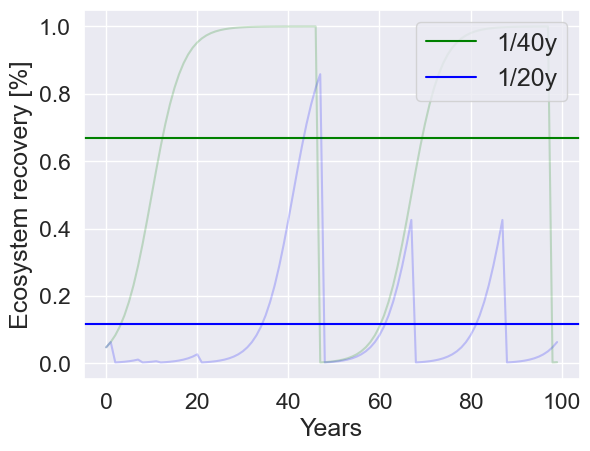

In [87]:
from result_methods import RESULTS
import matplotlib.pyplot as plt
fig, ax = plt.subplots()

x0 = -10
y = []

recov_time = 20
perturb_freq = 1/40
N_years = 100
rnd_picks = np.random.random(N_years)
years_perturb = np.where(rnd_picks < perturb_freq)[0]
x_array = np.arange(0, N_years)

for x in x_array:
    if x > years_perturb[0]:
        x0 = x
        if len(years_perturb) > 1:
            years_perturb = years_perturb[1:]
        else:
            years_perturb = [x_array[-1]]
    y.append(recovery_curve(x-x0, recov_time))
ax.plot(x_array,y, alpha=0.2, color='green')
ax.axhline(np.mean(y), 0, N_years, color='green' , label='1/40y')

years_at_max = np.sum(np.array(y) > 0.98)
ratio = years_at_max / (N_years - years_at_max)
print(f"The ratio of stable to recovery years is {ratio}")


x0 = -10
y = []

perturb_freq = 2/40
rnd_picks = np.random.random(N_years)
years_perturb = np.where(rnd_picks < perturb_freq)[0]
x_array = np.arange(0, N_years)

for x in x_array:
    if x > years_perturb[0]:
        x0 = x
        if len(years_perturb) > 1:
            years_perturb = years_perturb[1:]
        else:
            years_perturb = [x_array[-1]]
    y.append(recovery_curve(x-x0, recov_time))
ax.plot(x_array,y, alpha=0.2, color='blue')
ax.axhline(np.mean(y), 0, N_years, color = 'blue', label='1/20y')

years_at_max = np.sum(np.array(y) > 0.98)
ratio = years_at_max / (N_years - years_at_max)
print(f"The ratio of stable to recovery years is {ratio}")

ax.legend(loc='upper right')

ax.set_xlabel('Years')
ax.set_ylabel('Ecosystem recovery [%]')

fig.savefig(RESULTS / 'recovery_shema.pdf', bbox_inches='tight')